# **Dataset**
This dataset contains 25,000 histopathological images with 5 classes. All images are 768 x 768 pixels in size and are in jpeg file format.
The images were generated from an original sample of HIPAA compliant and validated sources, consisting of 750 total images of lung tissue (250 benign lung tissue, 250 lung adenocarcinomas, and 250 lung squamous cell carcinomas) and 500 total images of colon tissue (250 benign colon tissue and 250 colon adenocarcinomas) and augmented to 25,000 using the Augmentor package.

Since we are only dealing with colon tissues, we can remove the images related to the lungs

In [ ]:
!rm -r -f dataset
!kaggle datasets download -d andrewmvd/lung-and-colon-cancer-histopathological-images
!unzip lung-and-colon-cancer-histopathological-images.zip
!rm lung-and-colon-cancer-histopathological-images.zip
!mv lung_colon_image_set/colon_image_sets dataset
!rm -r -f lung_colon_image_set

Output streaming troncato alle ultime 5000 righe.
  inflating: lung_colon_image_set/lung_image_sets/lung_scc/lungscc1.jpeg  
  inflating: lung_colon_image_set/lung_image_sets/lung_scc/lungscc10.jpeg  
  inflating: lung_colon_image_set/lung_image_sets/lung_scc/lungscc100.jpeg  
  inflating: lung_colon_image_set/lung_image_sets/lung_scc/lungscc1000.jpeg  
  inflating: lung_colon_image_set/lung_image_sets/lung_scc/lungscc1001.jpeg  
  inflating: lung_colon_image_set/lung_image_sets/lung_scc/lungscc1002.jpeg  
  inflating: lung_colon_image_set/lung_image_sets/lung_scc/lungscc1003.jpeg  
  inflating: lung_colon_image_set/lung_image_sets/lung_scc/lungscc1004.jpeg  
  inflating: lung_colon_image_set/lung_image_sets/lung_scc/lungscc1005.jpeg  
  inflating: lung_colon_image_set/lung_image_sets/lung_scc/lungscc1006.jpeg  
  inflating: lung_colon_image_set/lung_image_sets/lung_scc/lungscc1007.jpeg  
  inflating: lung_colon_image_set/lung_image_sets/lung_scc/lungscc1008.jpeg  
  inflating: lung_co

#**Import of required libraries**
You need to upload the file `functions.py`, via the upload function of colab.



In [ ]:
import cv2
import numpy as np
import math
import glob
import os
import pandas as pd
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow
from sklearn.metrics import confusion_matrix
from tqdm.notebook import tqdm
import seaborn as sns
import random
from ipywidgets import interact, widgets, fixed
from skimage.color import rgb2gray
from scipy import ndimage
import skimage
from skimage.feature import graycomatrix, graycoprops
from mpl_toolkits.mplot3d import Axes3D
from sklearn.model_selection import train_test_split
from sklearn.decomposition import PCA
import time
import itertools
from sklearn.linear_model import LogisticRegression


#**Utility functions**

In [ ]:
def load_images_to_dataframe(path, label):
    file_names = os.listdir(path)
    data = []

    for file_name in file_names:
        file_path = os.path.join(path, file_name)
        # Append image and label to the data list
        data.append({'image': file_path, 'label': label})

    # Create DataFrame from the data
    df = pd.DataFrame(data)
    return df

def visualize_random_samples(df, class_labels, num_samples=5):
    # Sample random rows from the DataFrame
    random_samples = df.sample(n=num_samples)

    # Plot the images
    plt.figure(figsize=(15, 5*num_samples))
    for i, (_, row) in enumerate(random_samples.iterrows()):
        # Load the image from its path
        image = cv2.imread(row['image'])
        # Convert the image from BGR to RGB (matplotlib expects RGB)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

        plt.subplot(1, num_samples, i + 1)
        plt.imshow(image)
        plt.title(class_labels[row['label']])
        plt.axis('off')
    plt.show()

def plot_images(images, n=3):
    # Convert a single image to a list containing that image
    if not isinstance(images, list):
        images = [images]

    num_images = len(images)
    num_rows = (num_images + n - 1) // n  # Calculate the number of rows needed
    fig, axes = plt.subplots(num_rows, n, figsize=(4 * n, 4 * num_rows))

    for i, image in enumerate(images):
        row_index = i // n
        col_index = i % n
        if num_rows > 1:
            ax = axes[row_index, col_index]
        else:
            ax = axes[col_index]

        # Check if a cmap is specified for the image
        label = None
        if len(image) == 1:
           img, cmap = image, 'viridis'  # Default colormap is 'viridis'
        elif len(image) == 2:
            img, cmap = image
        elif len(image) == 3:
          img, cmap, label = image

        if label is not None :
          ax.set_title(str(label))
        ax.imshow(img, cmap=cmap)
        ax.axis('off')

    # Hide any remaining empty subplots
    for i in range(num_images, num_rows * n):
        row_index = i // n
        col_index = i % n
        if num_rows > 1:
            axes[row_index, col_index].axis('off')
        else:
            axes[col_index].axis('off')

    plt.tight_layout()
    plt.show()

def plot_image(image, cmap = "viridis"):
    plot_images([(image, cmap)], n=2)

def resize_image(img, resolution):
    # Resize the image to the given resolution
    return cv2.resize(img, resolution)
def extract_blobs_with_color(binary_img):
    # Use connectedComponentsWithStats to extract blobs
    num_labels, labels, stats, centroids = cv2.connectedComponentsWithStats(np.uint8(binary_img))

    # Create an empty RGB image for the result with black background
    result = np.zeros((binary_img.shape[0], binary_img.shape[1], 3), dtype=np.uint8)

    # Assign different colors to each blob (excluding background)
    for label in range(1, num_labels):
        blob_mask = labels == label
        color = np.random.randint(0, 256, size=3)  # Random 3D color for each blob
        result[blob_mask] = color

    return result

# Function to normalize a column
def normalize_column(column):
    min_val = column.min()
    max_val = column.max()
    return (column - min_val) / (max_val - min_val)

def normalize_dataset(df, ignore_columns):
  # Normalize each column
  n_df = pd.DataFrame()
  for column in df.columns:
      if column not in ignore_columns:
        n_df[column] = normalize_column(df[column])
      else:
        n_df[column] = df[column]
  return n_df

def pca(df, n_comp = 3, with_res = False):

    # Perform PCA
    pca = PCA(n_components= n_comp)
    pca = pca.fit(df)
    principal_components = pca.transform(df)

    # Create DataFrame with principal components
    cols = ["col" + str(i + 1) for i in range(n_comp)]
    pca_df = pd.DataFrame(data=principal_components, columns = cols)
    if with_res:
      return pca_df, pca
    else:
      return pca_df


def average_prediction_time(classifier, images, f):
    total_time = 0.0
    for img in images:
        start_time = time.time()
        features = f(img)
        _ =  classifier.predict(features)
        end_time = time.time()
        total_time += (end_time - start_time)

    average_time = total_time / len(images)
    return average_time


def plot_3d_scatter(df, columns, label_column, ax):
    for label_value, color_value in zip(df[label_column].unique(), ['blue', 'red']):
        ax.scatter(df.loc[df[label_column] == label_value, columns[0]],
                   df.loc[df[label_column] == label_value, columns[1]],
                   df.loc[df[label_column] == label_value, columns[2]],
                   c=color_value, cmap='viridis', label=f'Label {label_value}')

    ax.set_xlabel(columns[0])
    ax.set_ylabel(columns[1])
    ax.set_zlabel(columns[2])
    ax.set_title(f'{columns[0]} vs {columns[1]} vs {columns[2]}')


def plot_2d_scatter(df, combination, label, ax, lim = True):
    classes = df[label].unique()
    for cls in classes:
        cls_data = df[df[label] == cls]
        ax.scatter(cls_data[combination[0]], cls_data[combination[1]], label=str(cls))

    # Fit logistic regression model
    X = df[list(combination)].values
    y = df[label].values
    model = LogisticRegression()
    model.fit(X, y)

    # Get the coefficients of the line
    coef = model.coef_[0]
    intercept = model.intercept_

    # Create a range of values for x-axis
    x_values = np.linspace(X[:, 0].min(), X[:, 0].max(), 100)
    y_values = -(coef[0] * x_values + intercept) / coef[1]

    # Plot decision boundary
    ax.plot(x_values, y_values, color='black', linestyle='--', label='Decision Boundary')
    if lim:
        ax.set_xlim([-1,1])
        ax.set_ylim([-1,1])
    ax.set_xlabel(combination[0])
    ax.set_ylabel(combination[1])

import math


def plot_columns(df, cols, n, size, label = "Label", permutation = False, lim = True):
  if permutation:
    scatter_combinations = list(itertools.permutations(df.columns[:-1], n))
  else:
    scatter_combinations = list(itertools.combinations(df.columns[:-1], n))
  rows = math.ceil(len(scatter_combinations) / cols)
  fig, axs = plt.subplots(rows, min(2,cols), figsize=size,
                          subplot_kw={'projection': '3d' if n == 3 else None})


  for ax, combination in zip(axs.flatten(), scatter_combinations):
      if n == 3:
        plot_3d_scatter(df, combination, label, ax)
      else:
        plot_2d_scatter(df, combination, label, ax, lim = lim)

  # Add legend to the last subplot
  handles, labels = ax.get_legend_handles_labels()
  fig.legend(handles, labels, loc='upper left')

  # Show plots
  plt.show()

def compare_image_channels(img1, img2, title1 = "image-1", title2 = "image-2"):
    # Create subplots for each channel
    plt.figure(figsize=(12, 6))


    plt.subplot(2, 3, 1)
    plt.imshow(img1[:, :, 0], cmap='Reds')
    plt.title(title1 + '- Red Channel')

    plt.subplot(2, 3, 2)
    plt.imshow(img1[:, :, 1], cmap='Greens')
    plt.title(title1 + '- Green Channel')

    plt.subplot(2, 3, 3)
    plt.imshow(img1[:, :, 2], cmap='Blues')
    plt.title(title1 + '- Blue Channel')

    # Plot image 2 channels

    plt.subplot(2, 3, 4)
    plt.imshow(img2[:, :, 0], cmap='Reds')
    plt.title(title2 +' - Red Channel')

    plt.subplot(2, 3, 5)
    plt.imshow(img2[:, :, 1], cmap='Greens')
    plt.title(title2 + '- Green Channel')

    plt.subplot(2, 3, 6)
    plt.imshow(img2[:, :, 2], cmap='Blues')
    plt.title(title2 +' - Blue Channel')

    plt.tight_layout()
    plt.show()

def compare_image_distribution(img, img2, title1 = "image-1", title2 = "image-2"):
    imhsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    imhsv2 = cv2.cvtColor(img2, cv2.COLOR_BGR2HSV)

    # Create a figure with subplots
    fig = plt.figure(figsize=(12, 12))

    # Plot the RGB scatter plots for the first row
    ax1 = fig.add_subplot(221, projection='3d')
    r, g, b = img[:, :, 0].flatten(), img[:, :, 1].flatten(), img[:, :, 2].flatten()
    ax1.scatter(r, g, b)
    ax1.set_xlabel('Red')
    ax1.set_ylabel('Green')
    ax1.set_zlabel('Blue')
    ax1.set_title(title1 +'- RGB Scatter Plot')

    ax2 = fig.add_subplot(222, projection='3d')
    r2, g2, b2 = img2[:, :, 0].flatten(), img2[:, :, 1].flatten(), img2[:, :, 2].flatten()
    ax2.scatter(r2, g2, b2)
    ax2.set_xlabel('Red')
    ax2.set_ylabel('Green')
    ax2.set_zlabel('Blue')
    ax2.set_title(title2 +'- RGB Scatter Plot')

    # Plot the HSV scatter plots for the second row
    ax3 = fig.add_subplot(223, projection='3d')
    h, s, v = imhsv[:, :, 0].flatten(), imhsv[:, :, 1].flatten(), imhsv[:, :, 2].flatten()
    ax3.scatter(h, s, v)
    ax3.set_xlabel('Hue')
    ax3.set_ylabel('Saturation')
    ax3.set_zlabel('Value')
    ax3.set_title(title1 +'- HSV Scatter Plot')

    ax4 = fig.add_subplot(224, projection='3d')
    h2, s2, v2 = imhsv2[:, :, 0].flatten(), imhsv2[:, :, 1].flatten(), imhsv2[:, :, 2].flatten()
    ax4.scatter(h2, s2, v2)
    ax4.set_xlabel('Hue')
    ax4.set_ylabel('Saturation')
    ax4.set_zlabel('Value')
    ax4.set_title(title2 +'- HSV Scatter Plot')

    plt.tight_layout()
    plt.show()

# **Image analysis**


## **Loading the dataset**


In [ ]:
colon_aca = load_images_to_dataframe('dataset/colon_aca', 1)
colon_n = load_images_to_dataframe('dataset/colon_n', 0)
class_labels = ['benign', 'aca']

# Concatenate the dataframes
df = pd.concat([colon_aca, colon_n], ignore_index=True)
df.describe()
benign = df[df['label'] == 0]
acas = df[df['label'] == 1]

Visualization of some random samples

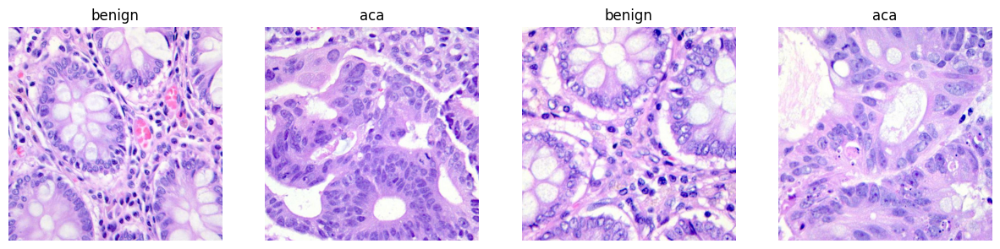

In [ ]:
visualize_random_samples(df,class_labels, num_samples=4)

## **Class distribution analysis**
The distribution of classes is perfectly balanced.
- 5000 examples of benign tissues
- 5000 examples of adenocarcinoma tissues (aca)

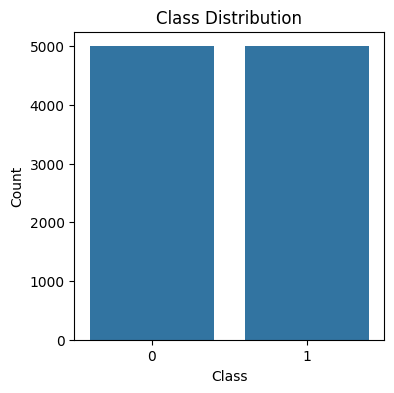

In [ ]:
class_counts = df['label'].value_counts()

# Create a bar plot
plt.figure(figsize=(4, 4))
sns.barplot(x=class_counts.index, y=class_counts.values)
plt.title('Class Distribution')
plt.xlabel('Class')
plt.ylabel('Count')
plt.show()

## **Image color histogram**
After calculating the average color histogram with respect to all the images of the two classes, it can be seen that there is no substantial diversity between the images of the two classes. One can, however, observe a higher frequency in the blue channel of images related to benign cells than in non-benign cells, where lower frequency values can be observed.

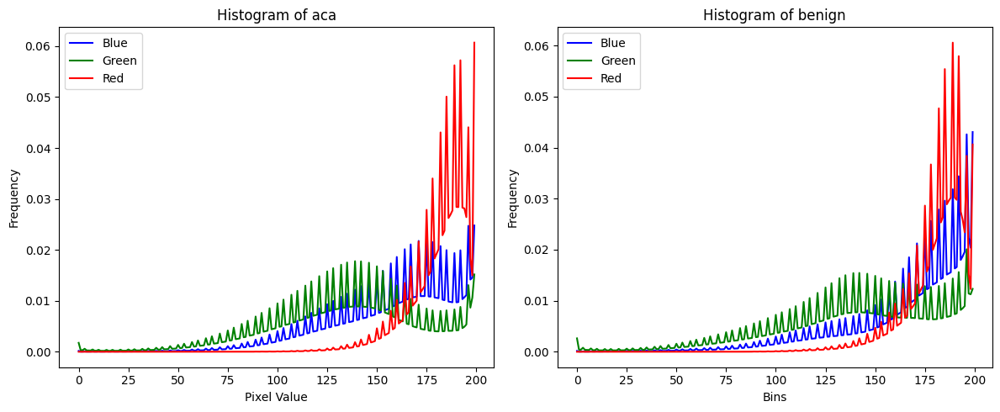

In [ ]:
# Function to calculate and plot the histogram
def calculate_and_plot_histogram(df, bin_count=256):
    # Initialize histograms for each color channel
    hist_b = []
    hist_g = []
    hist_r = []


    for image_path in df['image']:

        image = cv2.imread(image_path)
        image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

        # Calculate the histogram for each color channel
        b = cv2.calcHist([image_rgb], [0], None, [bin_count], [0, 256])
        g = cv2.calcHist([image_rgb], [1], None, [bin_count], [0, 256])
        r = cv2.calcHist([image_rgb], [2], None, [bin_count], [0, 256])
        hist_b.append(b / b.sum())
        hist_g.append(g / g.sum())
        hist_r.append(r / r.sum())

    # Calculate the average histograms over all images
    hist_b = sum(hist_b) / len(hist_b)
    hist_g = sum(hist_g) / len(hist_g)
    hist_r = sum(hist_r) / len(hist_r)
    return hist_b, hist_g, hist_r

n = 500
bin_count = 200
b, g, r    = calculate_and_plot_histogram(df[df['label'] == 1].sample(n), bin_count)
b2, g2, r2 = calculate_and_plot_histogram(df[df['label'] == 0].sample(n), bin_count)

# Plot the histograms
fig, axs = plt.subplots(1, 2, figsize=(12, 5))

axs[0].plot(b, color='b', label='Blue')
axs[0].plot(g, color='g', label='Green')
axs[0].plot(r, color='r', label='Red')
axs[0].set_title("Histogram of aca")
axs[0].set_xlabel('Pixel Value')
axs[0].set_ylabel('Frequency')
axs[0].legend()

axs[1].plot(b2, color='b', label='Blue')
axs[1].plot(g2, color='g', label='Green')
axs[1].plot(r2, color='r', label='Red')
axs[1].set_title("Histogram of benign")
axs[1].set_xlabel('Bins')
axs[1].set_ylabel('Frequency')
axs[1].legend()

plt.tight_layout()
plt.show()


In [ ]:
def histograms_metrics(h1,h2):
   # Compute the correlation
    correlation = cv2.compareHist(h1, h2, cv2.HISTCMP_CORREL)

    # Compute the intersection
    intersection = cv2.compareHist(h1, h2, cv2.HISTCMP_INTERSECT)

    return correlation, intersection

In [ ]:
for h,h2,ch in [(r,r2, "red"), (b,b2, "blue"), (g,g2, "green")]:
  c,i = histograms_metrics(h, h2)
  print(f"{str(ch)} correlation: {c}")
  print(f"{str(ch)} intersection: {i}\n")

red correlation: 0.9878634992750629
red intersection: 0.9519204708816014

blue correlation: 0.9092850698166917
blue intersection: 0.8215820085497398

green correlation: 0.9198890174600253
green intersection: 0.8820532336394535



## **Color differences between classes**

Selezioniamo un'immagine per classe su cui andremo ad effettuare i confronti

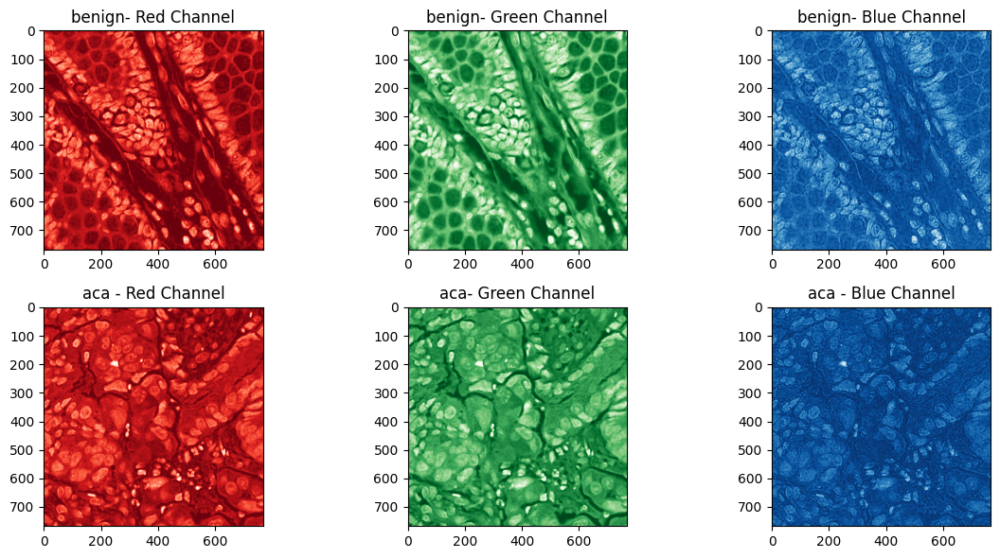

In [ ]:
image_path = acas.sample(1).iloc[0]['image']
aca_image = cv2.cvtColor(cv2.imread(image_path), cv2.COLOR_BGR2RGB)

image_path = benign.sample(1).iloc[0]['image']
b_image = cv2.cvtColor(cv2.imread(image_path), cv2.COLOR_BGR2RGB)

compare_image_channels(b_image, aca_image, "benign", "aca")

Visualize on a 3d space the pixel value distribution of two images of different classes

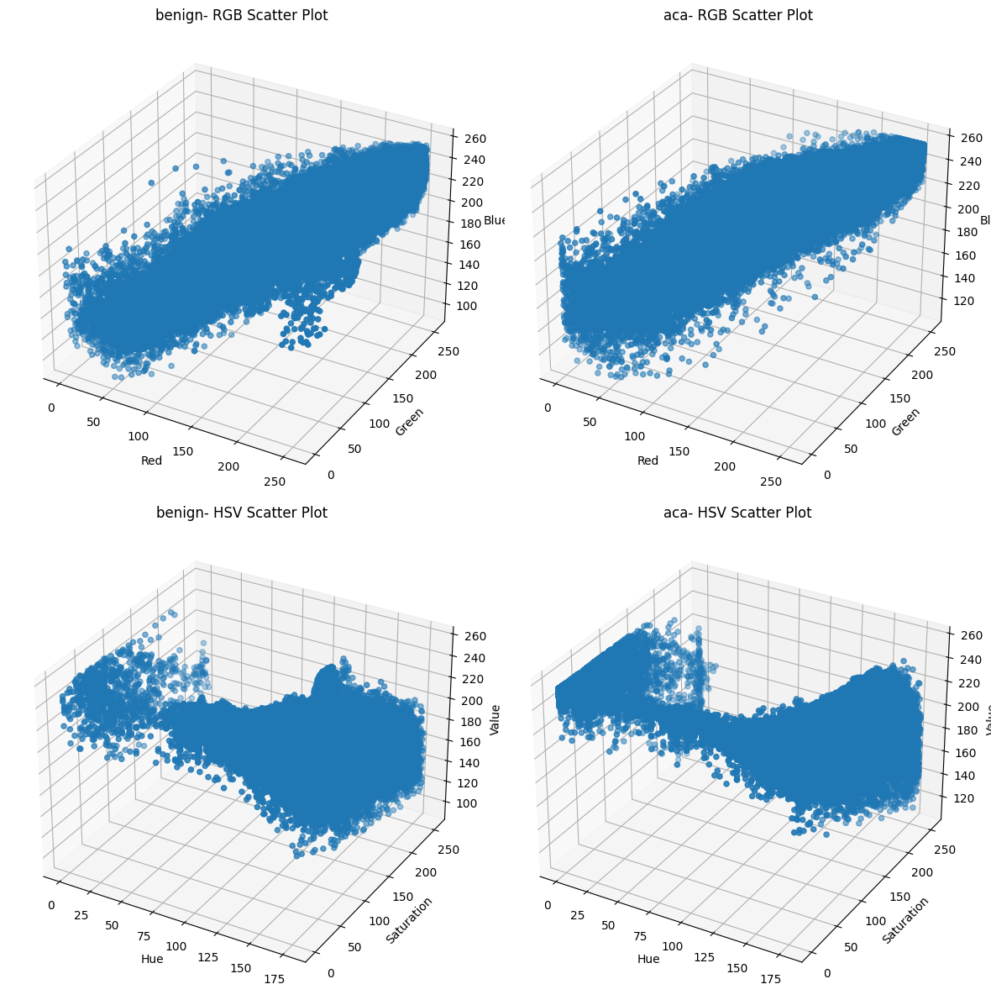

In [ ]:
compare_image_distribution(b_image, aca_image, "benign", "aca")

Looking at both color spaces shows no evident differences

## **Color moments**

Calculates the color moments for each channel of an image:

- `mean()` = $\frac{1}{N} \sum_{i=1}^{N} x_i$

  where $x_i$ are the values and $N$ is the number of values.

- `standard_deviation()` = $\sqrt{\frac{1}{N} \sum_{i=1}^{N} (x_i - \text{mean})^2}$

  where $x_i$ are the values, $N$ is the number of values, and $\text{mean}$ is the mean of the values.

- `skewness()` = $ \sqrt[3]{\frac{1}{N} \sum_{i=1}^{N} (x_i - \text{mean})^3} $

  where $x_i$ are the values, $N$ is the number of values, and $\text{mean}$ is the mean of the values.

In [ ]:
def mean(matrix):
    return matrix.sum() / (matrix.shape[0] * matrix.shape[1])
def std_deviation(matrix):
    m = mean(matrix)
    return  math.sqrt(np.sum((matrix - m) ** 2) / (matrix.shape[0] * matrix.shape[1]))
def skewness(matrix):
    m = mean(matrix)
    root_cube = lambda x: x**(1./3.) if 0<=x else -(-x)**(1./3.)
    return root_cube(np.sum((matrix - m) ** 3) / (matrix.shape[0] * matrix.shape[1]))

def color_moments(img):
  means = []
  stds = []
  skews = []
  for i in range(3):
    channel = img[:, :, i]
    means.append(mean(channel))
    stds.append(std_deviation(channel))
    skews.append(skewness(channel))
  return means, stds, skews

We calculate these global descriptors on the individual channels of n images of different classes:
- Mean,
- Standard deviation
- Skewness



In [ ]:
n = 1000
data = []
for sample, label in [(benign.sample(n)['image'], "benign"), (acas.sample(n)['image'], "aca")]:
  for img in sample:
      entry = {}
      m, std, skew = color_moments(cv2.cvtColor(cv2.imread(img), cv2.COLOR_BGR2RGB))
      for i, c in enumerate(["red","green","blue"]):
        entry.update({
            ("mean-" + str(c)): m[i],
            ("std-" + str(c)): std[i],
            ("skewness-" + str(c)): skew[i],
        })
      entry['label'] = label
      data.append(entry)

combined_moments_df = pd.DataFrame(data)

In [ ]:
combined_moments_df[combined_moments_df['label'] == "benign" ].describe()

,mean-red,std-red,skewness-red,mean-green,std-green,skewness-green,mean-blue,std-blue,skewness-blue
count,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000
mean,213.551656,39.804551,-45.688925,181.449032,50.668364,-46.038741,232.907329,17.913632,-21.817467
std,6.278739,3.651250,2.789854,9.778954,3.801123,3.958610,4.423356,1.573805,1.764290
min,194.060374,25.484197,-53.702462,153.852237,37.752842,-61.302887,218.287971,10.931242,-27.159809
25%,209.453929,37.290372,-47.728096,174.563867,48.091750,-48.202084,231.024342,16.944967,-22.849850
50%,214.217909,39.715723,-46.073862,182.145810,50.506042,-45.893443,233.424615,18.029036,-21.800127
75%,217.949416,42.171138,-43.857036,188.037872,52.907200,-43.536034,235.639506,19.011816,-20.750177
max,232.908374,49.327925,-33.609634,214.537362,61.544247,-34.340284,245.218124,21.736850,-13.823478


In [ ]:
combined_moments_df[combined_moments_df['label'] == "aca" ].describe()

,mean-red,std-red,skewness-red,mean-green,std-green,skewness-green,mean-blue,std-blue,skewness-blue
count,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000
mean,202.374938,37.669916,-36.035385,174.092448,44.474102,-29.941871,232.969839,17.208538,-19.229674
std,11.157359,4.756611,8.330820,14.350029,6.207675,20.180699,4.697154,2.899473,3.593904
min,172.228507,22.731030,-53.838507,134.056256,24.768813,-66.607096,215.229309,6.450857,-33.126404
25%,195.408926,34.348990,-41.890138,164.938363,40.296787,-40.626798,230.731622,15.365587,-22.026955
50%,201.199236,37.847402,-36.303838,174.655668,44.503117,-34.678116,233.200124,17.161761,-18.877724
75%,208.925121,40.786959,-31.687224,183.286986,47.811798,-26.748281,235.427200,18.998488,-16.405792
max,231.318854,55.620372,20.056223,215.426197,64.156755,47.596156,250.037338,28.436282,-9.626967


In [ ]:
 def compute_euclidean_distances(df):
    # Subset the DataFrame based on the label column
    df_aca = df[df['label'] == 'aca']
    df_benign = df[df['label'] == 'benign']
    distances = {}
    for ch in ["red", "blue", "green"]:
    # Calculate average for each attribute across color channels
      aca_mean = df_aca['mean-'+ch].mean()
      aca_std = df_aca['std-'+ch].mean()
      aca_skew = df_aca['skewness-'+ch].mean()

      b_mean = df_benign['mean-'+ch].mean()
      b_std = df_benign['std-'+ch].mean()
      b_skew = df_benign['skewness-'+ch].mean()


      # Compute Euclidean distance for each property
      distance_mean = np.linalg.norm(aca_mean - b_mean)
      distance_std = np.linalg.norm(aca_std - b_std)
      distance_skewness = np.linalg.norm(aca_skew - b_skew)

      # Return distances as a dictionary or Series
      distances['mean-'+ch] =  distance_mean
      distances['std-'+ch] =  distance_std
      distances['skewness-'+ch] =  distance_skewness

    return distances

In [ ]:
distances = compute_euclidean_distances(combined_moments_df)

# Print the computed distances
print("Euclidean Distances:")
for key, value in distances.items():
   print("{}: {:.4f}".format(key, value))

Euclidean Distances:
mean-red: 11.1767
std-red: 2.1346
skewness-red: 9.6535
mean-blue: 0.0625
std-blue: 0.7051
skewness-blue: 2.5878
mean-green: 7.3566
std-green: 6.1943
skewness-green: 16.0969


We can see that the color moments are very similar between images of different classes.

Intuitively, they should not be very useful in order to discriminate images of benign and non-benign tissues.

# **Image preprocessing**
It's important to perform preprocessing on the images in order to reduce any noise present images.

We load two example images on which we are going to perform the transformations

In [ ]:
b_img = cv2.imread(benign.sample(1)['image'].iloc[0])
a_img = cv2.imread(acas.sample(1)['image'].iloc[0])

### **Resize**

It is appropriate to resize images before performing other operations in order to:

 - **Reduce Execution Time**
 - **Reduce the impact in Memory**

In [ ]:
image_size =(130,130)
b_img = resize_image(b_img, image_size)
a_img = resize_image(a_img, image_size)

### **Denoising**

In order to reduce image noise, a series of transformations are applied, which include:

1. **Contrast Enhancement**:
   - The image is first enhanced in contrast using [CLAHE (Contrast Limited Adaptive Histogram Equalization)](https://docs.opencv.org/4.x/d6/dc7/group__imgproc__hist.html#gaa8dff9c3c1efc516cd7e3dfcf0a63e75). This process makes details more visible and better balances the light and dark areas of the image.

2. **Median Filter**:
   - Next, the contrast-enhanced image was subjected to a [median filter](https://docs.opencv.org/4.x/d4/d86/group__imgproc__filter.html#ga8c45db9afe636703801b0b2e440fce37) with a 5x5 kernel size. The median filter helps to reduce noise while maintaining sharp edges.

3. **Non-Local Denoising**:
   - Finally, a [non-local denoising](https://docs.opencv.org/4.x/d5/d69/tutorial_py_non_local_means.html) was applied to the filtered image. This method further reduces noise while maintaining the important features of the image.


In [ ]:
def modify_image(gray):

    # Apply contrast enhancement
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8))
    enhanced_contrast = clahe.apply(gray)

    # Apply median filter
    median_filtered = cv2.medianBlur(enhanced_contrast, 5)

    # Apply non-local means denoising
    denoised = cv2.fastNlMeansDenoising(median_filtered, None, 10, 7, 21)

    return {
        "original_gray": gray,
        "median_filtered": median_filtered,
        "denoised": denoised,
        "enhanced_contrast": enhanced_contrast
    }


## **Grayscale conversion**

As noted earlier, it is possible to work on the grayscale version of the image. Once the conversion to grayscale has been applied, let us look at the steps taken to reduce the noise within the image, using the function defined earlier.

The goal is to go to highlight the edges of those circular structures present within the images related to benign tissues.



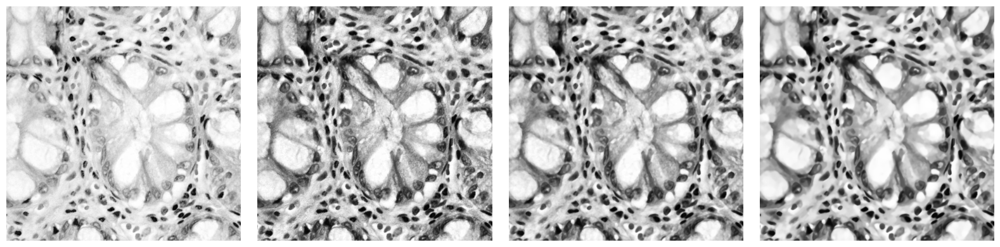

In [ ]:
gray = cv2.cvtColor(cv2.imread(benign.sample(1)['image'].iloc[0]), cv2.COLOR_BGR2GRAY)
r = modify_image(gray)
plot_images([(r['original_gray'],"gray"),(r['enhanced_contrast'],"gray"),(r['median_filtered'],"gray"),(r['denoised'],"gray")], n=4)

##**Defining preprocessing function**
We define, then, a preprocessing function that applies the previous transformations to an image

In [ ]:
def preprocess_image(img, read = False, resize_after = False):
  if read:
    img = cv2.imread(img)
  gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
  if not resize_after:
    gray = resize_image(gray, image_size)
  clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8))
  en_contrast = clahe.apply(gray)
  median_blur = cv2.medianBlur(en_contrast, 5)
  denoised = cv2.fastNlMeansDenoising(median_blur, None, 10, 7, 21)
  if resize_after:
    denoised = resize_image(denoised, image_size)
  return denoised


Let's visualize the transformations on some images

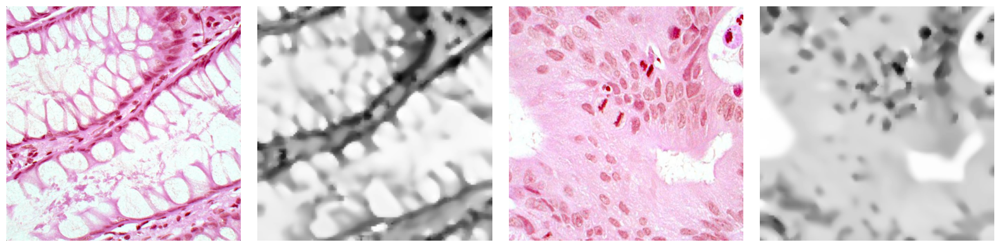

In [ ]:
b = cv2.imread(benign.sample(1)['image'].iloc[0])
a = cv2.imread(acas.sample(1)['image'].iloc[0])
b_gray = preprocess_image(b)
a_gray = preprocess_image(a)
plot_images([(b, "gray"),(b_gray, "gray"),
             (a, "gray"),(a_gray, "gray")], n = 4)

# **GLCM feature extraction**

The `extract_features` function extracts a feature vector (a numpy array with 5 elements) from an undirected co-occurrence matrix `M`.

The feature vector will contain the values of *energy*, *entropy*, *contrast*, *homogeneity*, *dissimilarity*, *cluster shading*, *cluster prominence*, *maximum likelihood*, *inverse difference momentum (IDM)* and *variance* calculated as follows:

* **Energy**: $\sqrt{\sum_{i,j} M[i,j]^2}$
* **Entropy**: $-\sum_{i,j} M[i,j] \cdot \log(M[i,j])$
* **Contrast**: $-\sum_{i,j} (i-j)^2 \cdot M[i,j]$
* **Homogeneity**: $\sum_{i,j} \frac{M[i,j]}{1 + i-j \mid}$
* **Dissimilarity**: $\sum_{i,j} \mid i-j \mid \cdot M[i,j]$

We can exclude the black pixels when computing the glcm, since the average number of black pixels in all the images is `0.0035`

In [ ]:
total = []
n = 10000
for img_path in df['image'].sample(n):
  image = cv2.cvtColor(cv2.imread(img_path), cv2.COLOR_BGR2RGB)
  black_pixels =  np.sum(np.all(image == [0, 0, 0], axis=-1))
  total.append(black_pixels)

# Count black pixels
total = np.array(total)
mean = total.mean()
print(mean)

[1 1 1 2 1 1 1 1 2 1 3 1 1 3 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
0.0035


In [ ]:
def extract_features(image):

    # Define the distances and angles for GLCM computation
    distances = [1, 3, 5]
    angles = [0, np.pi/4, np.pi/2, 3*np.pi/4]

    # Compute the GLCM
    glcm = graycomatrix(image, distances=distances, angles=angles, levels=256, symmetric=True, normed=True)
    glcm= glcm[1:,1:]

    # Compute GLCM properties (contrast, dissimilarity, homogeneity, energy)
    contrast = graycoprops(glcm, 'contrast')
    dissimilarity = graycoprops(glcm, 'dissimilarity')
    homogeneity = graycoprops(glcm, 'homogeneity')
    correlation = graycoprops(glcm, 'correlation')
    energy = graycoprops(glcm, 'energy')

    # Combine all features into a dictionary
    features = {
        'contrast': contrast.mean(),
        'dissimilarity': dissimilarity.mean(),
        'homogeneity': homogeneity.mean(),
        'correlation': correlation.mean(),
        'energy': energy.mean()
    }

    return features

#**Elliptical structures detection**
We define some function needed by the algorithm

## Small blob removals

`remove_small_blobs` function processes a binary image to remove connected components (blobs) based on their size. It uses connected component analysis to identify and evaluate blobs, then removes those that are either smaller or larger than a the average size of all the **blobs×gamma**, depending on the `reverse` parameter.
The function performs connected component analysis on the binary image using [cv2.connectedComponentsWithStats](https://docs.opencv.org/3.4/d3/dc0/group__imgproc__shape.html#ga107a78bf7cd25dec05fb4dfc5c9e765f), which returns the number of labels, label matrix, statistics, and centroids of the blobs. If there are any blobs other than the background, the function calculates the average area of these blobs.The function then determines the minimum area threshold by multiplying the average blob area by `gamma`.
Depending on the `reverse` parameter, blobs either smaller or larger than this threshold are marked for removal by setting their corresponding pixels to the background (0).

In [ ]:
def remove_small_blobs(image, gamma, reverse = False):
    # Perform connected component analysis to get stats
    num_labels, labels, stats, centroids = cv2.connectedComponentsWithStats(image, connectivity=8)

    # Calculate average blob area excluding background (stats[0])
    if len(stats) > 1:  # Check if there are any components other than the background
        average_area = np.mean(stats[1:, cv2.CC_STAT_AREA])
        min_area = average_area * gamma

        # Remove blobs smaller than average area * gamma
        for i in range(1, num_labels):
            area = stats[i, cv2.CC_STAT_AREA]
            if  (reverse and area > min_area) or (not reverse and area < min_area):
                # Set pixels of small blobs to background (0)
                labels[labels == i] = 0

        # Create mask of remaining blobs
        mask = np.where(labels > 0, 255, 0).astype(np.uint8)

        # Apply the mask to the original image to remove small blobs
        result_image = cv2.bitwise_and(image, image, mask=mask)
        return result_image

    else:
        return image


## Holes filling
- The `add_border` function *adds* a border of 1 pixel to the specified side of the given binary image.
- The `remove_border` function *removes* a border of 1 pixel to the specified side of the given binary image.
- The `try_fill_holes` function processes a binary image to fill holes by adding borders, filling the holes using the [binary_fill_holes](https://docs.scipy.org/doc/scipy/reference/generated/scipy.ndimage.binary_fill_holes.html) function, and then removing the borders. This can be done for each side of the image individually or for pairs of sides if the `two_sided` parameter is set to `True`.



In [ ]:
def add_border(image, side):
    """
    Adds a border of 1 pixel to the specified side of the image.
    """
    width, height = image.shape
    new_image = np.ones((width + 2, height + 2), dtype=np.uint8)
    new_image[1:-1, 1:-1] = image

    if side == 'left':
        return new_image[:-1, 1:-1] # Adding border on the left side
    elif side == 'top':
        return new_image[1:-1, :-1]  # Adding border on the top side
    elif side == 'right':
       return new_image[1:, 1:-1]  # Adding border on the right side
    elif side == 'bottom':
        return new_image[1:-1, 1:]  # Adding border on the bottom side


def remove_border(image, side):
    """
    Removes the border added by add_border function based on the specified side.
    """
    if side == 'top':
        return image[:, 1:]
    elif side == 'left':
        return image[1:, :]
    elif side == 'right':
        return image[:-1, :]
    elif side == 'bottom':
        return image[:, :-1]

def try_fill_holes(image, two_sided = False):
    """
    Process the image by adding borders, filling holes, and removing borders.
    """

     # Add border, fill holes, and remove border for each side
    sides = ['left', 'top', 'right', 'bottom']
    processed_images = []
    for side in sides:
        temp_image = add_border(image, side)
        filled_image = ndimage.binary_fill_holes(np.uint8(temp_image))
        if not two_sided:
          processed_images.append(remove_border(filled_image, side))
        else:
          # if we want o to close holes that are between two borders
          next_side = sides[(sides.index(side) + 1) % len(sides)]
          temp_image = add_border(temp_image, next_side)
          filled_image = ndimage.binary_fill_holes(np.uint8(temp_image))
          filled_image = remove_border(filled_image, side)
          filled_image = remove_border(filled_image, next_side)
          processed_images.append(filled_image)


    # Create an empty array of the same shape as the original image
    or_image = np.zeros_like(image, dtype=np.uint8)

    # Perform bitwise OR operation for each side's processed image
    for side_image in processed_images:
        or_image = np.bitwise_or(or_image, side_image)

    return or_image

## Blob properties

The `compute_blob_properties` function calculates geometric properties of a given contour (blob) in a binary image. These properties include area, perimeter, and circularity. Optionally, the function can plot the contour with the calculated circularity.The the area of the contour is computed using [cv2.contourArea](https://docs.opencv.org/4.x/d3/dc0/group__imgproc__shape.html#ga2c759ed9f497d4a618048a2f56dc97f1).
The perimeter of the of the contour is computed using [cv2.arcLength](https://docs.opencv.org/4.x/d3/dc0/group__imgproc__shape.html#ga8d26483c636be6b35c3ec6335798a47c).

The circularity is computed using the formula: $(4 \times \pi \times \text{area}) / (\text{perimeter} \times \text{perimeter})$.

Other properties are commented to prevent useless computation since they are not used.


In [ ]:
def compute_blob_properties(blob, img, plot = False):

        # Calculate area and perimeter of the contour
        area = cv2.contourArea(blob)
        perimeter = cv2.arcLength(blob, True)
        # Check if perimeter is zero or area is very small, and skip the contour if true
        if perimeter < 20 or area < 50 or len(blob) < 5:
            return {
            #'eccentricity': 0,
            'circularity': 0
            #'hu_moments': [0,0,0,0,0,0,0],
            #'triangularity': 0
        }

        # Calculate the moments of the contour
        #moments = cv2.moments(blob)

        # Calculate eccentricity
        #eccentricity = np.sqrt((moments['mu20'] - moments['mu02']) ** 2 +
        # 4 * moments['mu11'] ** 2) / (moments['mu20'] + moments['mu02'])

        # Calculate triangularity
        #triangle_perimeter = np.sqrt(4 * np.pi * area)
        #triangularity_ratio = perimeter / triangle_perimeter

        # Calculate Hu moments
        #hu_moments = cv2.HuMoments(moments).flatten()

        # Calculate circularity
        circularity = (4 * np.pi * area) / (perimeter * perimeter)

        if plot:
          contour_image = np.zeros_like(img)
          cv2.drawContours(contour_image, [blob], -1, (255, 255, 255), 2)
          # Plot the contour image
          plt.imshow(contour_image, cmap='gray')
          plt.title(f'circularity: {circularity}')
          plt.axis('off')
          plt.show()
        return {
            #'eccentricity': eccentricity,
            'circularity': circularity,
            #'hu_moments': hu_moments,
            #'triangularity': triangularity_ratio
        }

## Non circular blobs removals

The `remove_non_circular_blobs` function processes a binary image to remove blobs that do not meet a specified circularity threshold. Blobs with circularity below the threshold are filled with black pixels (removed from the image). This function uses the [cv2.findContours](https://docs.opencv.org/3.4/d4/d73/tutorial_py_contours_begin.html) function to find the contours of the blobs in the image. For each contour, the function computes its properties using the `compute_blob_properties` function.

In [ ]:
def remove_non_circular_blobs(binary_image, threshold=0.85, min_area = 200, plot = False):
    # Convert the binary image to uint8
    img = np.uint8(binary_image.copy())

    # Find connected components with stats
    contours, _ = cv2.findContours(img, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    for contour in contours:
       r = compute_blob_properties(contour, img, plot)
      # print(r['circularity'])
       if r['circularity'] < threshold:
         # print(r['circularity'])
          cv2.drawContours(img, [contour], -1, 0, thickness=cv2.FILLED)

    return img

## Fill ellipses

The `fill_ellipses_in_binary_image` function processes a binary image by detecting blobs, fitting ellipses to each blob, and filling the detected ellipses with white pixels. It also ensures that the ellipses do not overlap with each other. This function uses [cv2.fitEllipse](https://docs.opencv.org/4.x/d3/dc0/group__imgproc__shape.html#gaf259efaad93098103d6c27b9e4900ffa) to fit an ellipse to the contour.

In [ ]:
def fill_ellipses_in_binary_image(binary_image):

    ellipses_masks = []
    # Find contours of the blobs
    contours, _ = cv2.findContours(binary_image, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # Create an empty image to draw ellipses
    filled_ellipses_image = np.zeros_like(binary_image)

    for contour in contours:
        if len(contour) >= 5:  # Minimum number of points required to fit an ellipse
            # Fit an ellipse to the contour
            ellipse = cv2.fitEllipse(contour)
            ellipse_mask = np.zeros_like(binary_image)
            # Draw the ellipse filled with white color on the empty image
            cv2.ellipse(ellipse_mask, ellipse, (255), thickness=-1)

            # Check for overlaps with previously drawn ellipses
            overlap = False
            for prev_mask in ellipses_masks:
                if np.any(cv2.bitwise_and(ellipse_mask, prev_mask)):
                    overlap = True
                    break

            # If no overlap, draw the ellipse and add the mask to the list
            if not overlap:
                cv2.ellipse(filled_ellipses_image, ellipse, (255), thickness=-1)
                ellipses_masks.append(ellipse_mask)

    return filled_ellipses_image


## **Algorithm**

The `process_image` function applies a series of operations on images in order to identify regions of interest. In this case, we want to identify the elliptical shapes inside the image. The following is a detailed description of the steps performed by the function:

- **Image Preprocessing**:
   - The `preprocess_image` function defined above is used.

- **Image Binarization**:
   - A binary threshold is applied to the preprocessed image with a `threshold` value. Pixels with values above the threshold are set to 255 (white), while pixels with values below are set to 0 (black).

- **Morphological Erosion**:
   - An initial morphological erosion is applied to the binarized image. The goal is to separate the internal part of elliptical structures from their edges.

- **Specific Image Management**:
  - We use two parameters to recognize strongly zoomed images and images where edges are less obvious: the percentage of pixels with values above 200 (light pixels) and the percentage of pixels with values below the `threshold` (dark pixels).
  - If the percentage of light pixels is greater than or equal to 0.46 or the percentage of dark pixels is less than 0.16, a morphological opening operation is applied. Images with a lot of zoom and those where the edges are very similar within the circular structures, typically need, an additional opening operation.

- **Individuation of elliptical structures**:
   
   A series of morphological opening and erosion operations are performed in order to distinguish elliptical tissue structures, from the rest of the image
   - A morphological opening operation is carried out first, followed by an erosion operation. In this way the central parts of the tissues, which are typically more "connected" than the rest of the image, should be able to separate from the edges.
   - We remove the small blobs of pixels from the image using the `remove_small_blobs` function. After the previous operations, in fact, the less connected areas tend to separate, creating very fragmented areas of small blobs of pixels. Since we are only interested in large (tissue interior) blobs, we can remove all blobs smaller than average.
   - We fill the holes in the image using the `fill_holes` function. As a result of the opening and erosion operations, holes may be created inside the larger blobs. It may be convenient to close them to better highlight the shape of the blob.
   - We remove the non-circular blobs using the `remove_non_circular_blobs` function. At this point we can remove blobs that do not reflect a circular shape. In this case, all blobs that have a circularity less than 0.2 are removed.
   - Using the function `fill_ellipses_in_binary_image`, an ellipse is drawn for each blob present in the image
   - Finally, a morphological dilation is applied to go to recover the initial blob size before erosion.

- **Mask Creation and Application**:
   - The binary mask, is applied to the original image.
   - The bitwise AND operation is used to combine the original image with the mask, resulting in the final image.

In [ ]:
def process_image(image, plot = True, read = True, threshold = 152):
    # Convert to grayscale
    p_img = preprocess_image(image, read = read)
    # Apply thresholding
    _, thresh = cv2.threshold(p_img, threshold, 255, cv2.THRESH_BINARY )

    # Perform morphological operations to clean up threshold image
    diameter = 4
    avg = np.sum(p_img > 200) / (p_img.shape[0] * p_img.shape[1])
    avg_b = np.sum(p_img <= threshold) / (p_img.shape[0] * p_img.shape[1])

    if plot:
      print("avg : " + str(avg))
      print("avg_b: " + str(avg_b))

    k = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (4, 4))
    k2 = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (5, 5))
    s0 = cv2.morphologyEx(thresh, cv2.MORPH_ERODE, k, iterations = 1)

    if avg >= 0.46 or avg_b < 0.17:
      sa = cv2.morphologyEx(s0, cv2.MORPH_OPEN, k2, iterations = 2)
    else:
      sa = s0

    s1 = cv2.morphologyEx(sa, cv2.MORPH_OPEN, k, iterations = 1)
    s2 = cv2.morphologyEx(s1, cv2.MORPH_ERODE, k, iterations = 1)
    s3 = remove_small_blobs(s2, 0.6)
    s4 = try_fill_holes(s3, False)
    s5 = remove_non_circular_blobs(s4.copy(), threshold = 0.22, plot = False)
    s6 = remove_small_blobs(s5, 0.8)
    s7 = fill_ellipses_in_binary_image(s6)
    s8 = cv2.morphologyEx(s7, cv2.MORPH_DILATE, k2, iterations = 2)

    mask = s8
    img = cv2.cvtColor(cv2.imread(image), cv2.COLOR_BGR2GRAY) if read else image
    img = resize_image(img, image_size)
    result = cv2.bitwise_and(img, img, mask=mask)
    if plot:
      plot_images([(p_img, "gray"),
                  (thresh, "gray"),
                  (extract_blobs_with_color(s0), "viridis"),
                  (extract_blobs_with_color(sa), "viridis"),
                  (extract_blobs_with_color(s1), "viridis"),
                  (extract_blobs_with_color(s2), "viridis"),
                  (extract_blobs_with_color(s3), "viridis"),
                  (extract_blobs_with_color(s4), "viridis"),
                  (extract_blobs_with_color(s5), "viridis"),
                  (extract_blobs_with_color(s6), "viridis"),
                  (extract_blobs_with_color(s7), "viridis"),
                  (extract_blobs_with_color(s8), "viridis"),
                  (result, "gray")], n = 13)
    # You can return the segmented image or mask as needed
    return result

## Steps visualization
We can visualize all the transformations applied by the `process_image` function, on two example images.

avg : 0.2875147928994083
avg_b: 0.3083431952662722


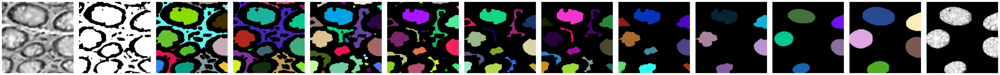

avg : 0.2610059171597633
avg_b: 0.3259763313609467


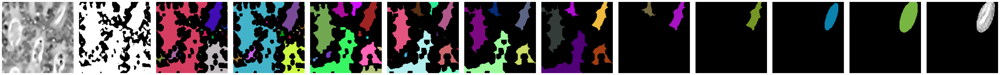

In [ ]:
b_gray = benign.sample(1)['image'].iloc[0]
a_gray = acas.sample(1)['image'].iloc[0]
_ = process_image(b_gray, plot = True)
_ = process_image(a_gray, plot = True)

We can now visualize some examples

avg : 0.40307692307692305
avg_b: 0.1337869822485207


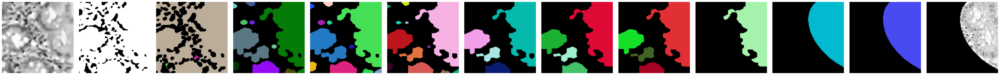

avg : 0.44804733727810653
avg_b: 0.28384615384615386


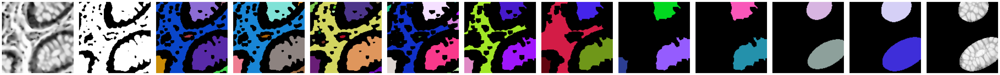

avg : 0.2677514792899408
avg_b: 0.2730177514792899


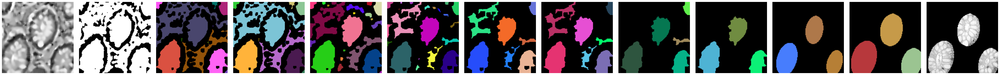

avg : 0.34893491124260356
avg_b: 0.19112426035502958


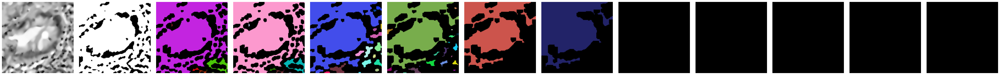

In [ ]:
for img in benign.sample(n = 4)['image']:
  _ = process_image(img, read = True, plot = True)

# **Dataset definition**
The `make_dataset` function, takes as input a list of file_paths, containing the paths to the images in the dataset, then, optionally, for each of them it executes the `process_image` function, obtaining the processed image. For each image, features are then extracted using the previously defined function `extract_features`. Finally, a dataframe is created with the extracted features.

In [ ]:
def make_dataset(image_files, label, process = True):
    data = []
    for f in image_files:
        # Load image
        if process:
          res = process_image(f, False, True)
        else :
          res = preprocess_image(f, True, True)

        # Compute texture properties
        r = extract_features(res)

        # Store properties and label
        data.append(list(r.values()) + [f, label])

        # Create DataFrame
        df = pd.DataFrame(data, columns=list(r.keys()) + ['image', 'Label'])
    return df

# **Feature analysis**
We can visualize the distribution of the images in the GLCM features space.

## **Without detection algorithm**

In [ ]:
# Extract texture features for each class
n = 100
bening_df_full = make_dataset(benign['image'].sample(n = n), label=0,  process = False)
aca_df_full = make_dataset(acas['image'].sample(n = n), label=1, process = False)

# Concatenate the DataFrames for both classes
combined_df_full = pd.concat([bening_df_full, aca_df_full], ignore_index=True)
combined_df_full.describe()

,contrast,dissimilarity,homogeneity,correlation,energy,Label
count,200.000000,200.000000,200.000000,200.000000,200.000000,200.000000
mean,4408.292443,48.342188,0.047110,0.400627,0.010352,0.500000
std,860.603745,6.006526,0.016132,0.083437,0.003442,0.501255
min,1651.494163,26.199300,0.025139,0.205580,0.007474,0.000000
25%,3854.131049,44.916390,0.036908,0.342365,0.008324,0.000000
50%,4498.981579,48.607946,0.044302,0.398085,0.009255,0.500000
75%,5060.968752,52.759787,0.050936,0.455631,0.010491,1.000000
max,6333.881347,59.430687,0.120981,0.664136,0.031057,1.000000


### Normalization
We normalize features between 0 and 1.

In [ ]:
normalized_df_full = normalize_dataset(combined_df_full, ignore_columns = ["image", "label"])
normalized_df_full.describe()

,contrast,dissimilarity,homogeneity,correlation,energy,Label
count,200.000000,200.000000,200.000000,200.000000,200.000000,200.000000
mean,0.588759,0.666325,0.229245,0.425352,0.122059,0.500000
std,0.183796,0.180749,0.168315,0.181955,0.145951,0.501255
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.470409,0.563235,0.122799,0.298296,0.036057,0.000000
50%,0.608127,0.674322,0.199944,0.419809,0.075522,0.500000
75%,0.728149,0.799259,0.269166,0.545301,0.127951,1.000000
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


### Visualization

A `pca` function is defined to reduce the dimensionality of a dataframe, using the **Principal Component Analysis**. This feature will, in this case, be used only to display the feature distribution on the screen.

<ipython-input-27-a951be6d4e05>:143: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(df.loc[df[label_column] == label_value, columns[0]],


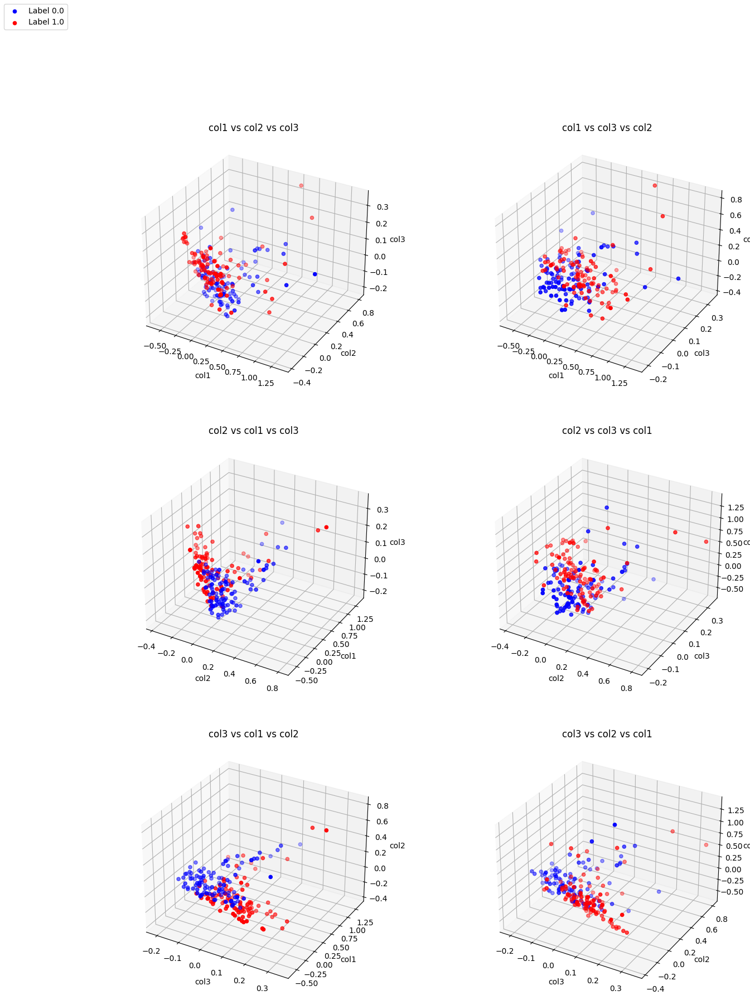

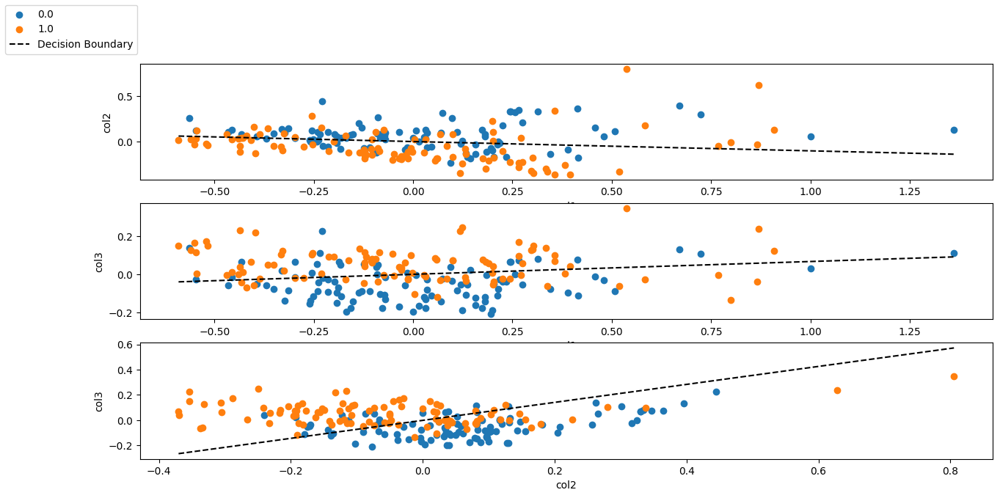

In [ ]:
pca_df_full = pca(normalized_df_full.drop(columns= ['image', 'Label']))
pca_df_full["Label"] = normalized_df_full["Label"]
plot_columns(pca_df_full, 2, 3, (15,20), "Label", True, lim = False)
plot_columns(pca_df_full, 1, 2, (15,7), "Label", False, lim = False)

## **With detection algorithm**

We can now analyze the dataframe created on a sample of `n` images, using the `process_image`.

In [ ]:
# Extract texture features for each class
n = 100
bening_df = make_dataset(benign['image'].sample(n = n), label=0, process = True)
aca_df = make_dataset(acas['image'].sample(n = n), label=1,  process = True)

# Concatenate the DataFrames for both classes
combined_df_det = pd.concat([bening_df, aca_df], ignore_index=True)
aca_df.describe()

,contrast,dissimilarity,homogeneity,correlation,energy,Label
count,100.000000,100.000000,100.000000,100.000000,100.000000,100.0
mean,1289.505926,22.674578,0.059159,0.496541,0.022543,1.0
std,692.021862,10.779130,0.046353,0.241206,0.026180,0.0
min,0.000000,0.000000,0.000000,0.162624,0.000000,1.0
25%,1064.771019,21.675334,0.045538,0.337262,0.014503,1.0
50%,1372.580964,26.487898,0.055331,0.411668,0.018470,1.0
75%,1745.077204,29.247426,0.067937,0.523736,0.024395,1.0
max,2606.689115,37.918819,0.317038,1.000000,0.210939,1.0


In [ ]:
bening_df.describe()

,contrast,dissimilarity,homogeneity,correlation,energy,Label
count,100.000000,100.000000,100.000000,100.000000,100.000000,100.0
mean,1109.328421,22.359399,0.076846,0.471339,0.021340,0.0
std,498.673633,5.385964,0.022566,0.113034,0.006657,0.0
min,0.000000,0.000000,0.000000,0.216283,0.000000,0.0
25%,802.926250,19.716822,0.064634,0.403104,0.018044,0.0
50%,1007.008230,21.972664,0.074217,0.464403,0.019929,0.0
75%,1311.112782,24.859218,0.086629,0.517599,0.023356,0.0
max,2950.679669,38.291786,0.147038,1.000000,0.046668,0.0


### Visualization
We can visualize the feature distribution of the images in the dataset, after performing dimensionality reduction by PCA.

<ipython-input-27-a951be6d4e05>:143: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(df.loc[df[label_column] == label_value, columns[0]],


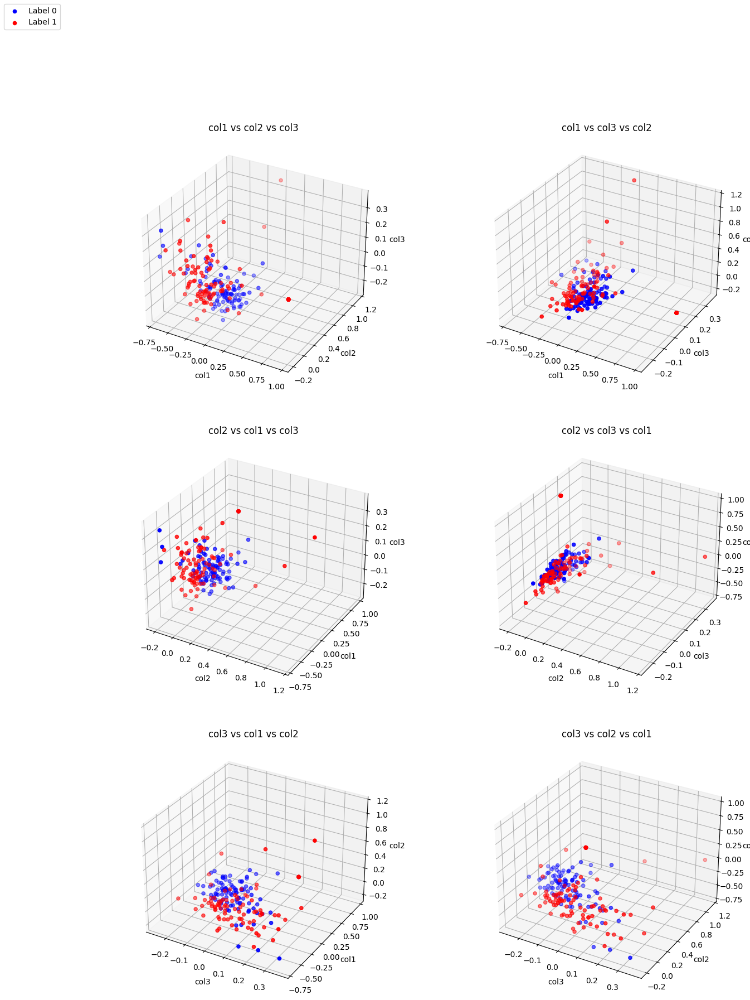

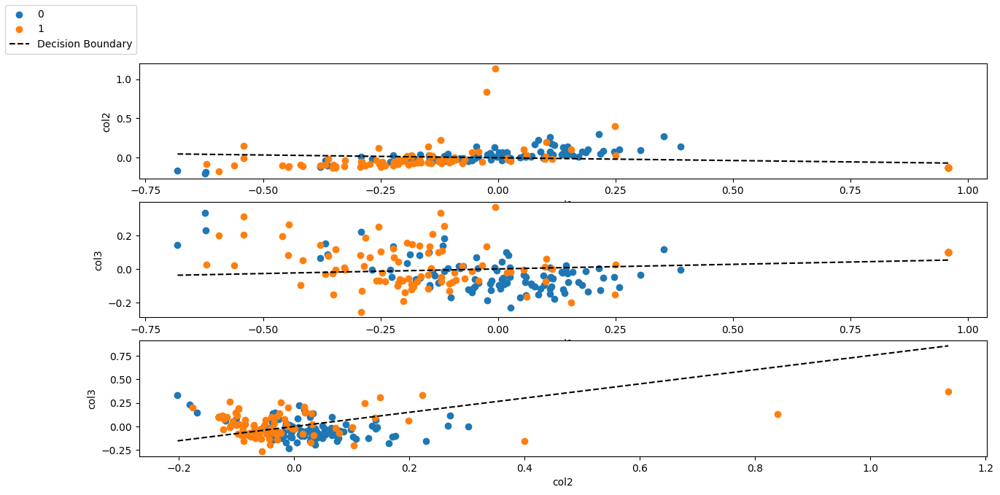

In [ ]:
pca_df = pca(normalize_dataset(combined_df_det,["image","label"]).drop(columns= ['image', 'Label']))
pca_df["Label"] = combined_df_det["Label"]
plot_columns(pca_df, 2, 3, (15,20), "Label", True, False)
plot_columns(pca_df, 1, 2, (15,7), "Label", False, False)

# **GLCM Features classification**

## **Import of required libraries**

In [ ]:
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.preprocessing import StandardScaler
from sklearn.svm import SVC
from sklearn.pipeline import Pipeline
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from multiprocessing import process
from xgboost import XGBClassifier
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix, roc_auc_score, roc_curve

## **Utility functions**

- `create_dataset()`: Extracts, for each of the 10000 images in the dataset, the features described above. Useful for creating the feature dataset that will be used for classification.


- `load_dataset_from_csv()`: Loads a dataset from a CSV file.


- `save_dataset_to_csv()` : Saves the feature dataset to a CSV file. It may be useful to save the dataset to file, since the process of extracting features of all images takes several minutes.

- `split_dataset()`: Splits a dataset into training, validation and testing.


- `plot_confusion_matrix()`: Displays the confusion matrix, useful for evaluating the performance of the classifier.


- `show_misclassified_images()`: This function displays `n` misclassified images on the test set.

In [ ]:
def create_dataset(process = True):
  bening_df = make_dataset(benign['image'], label=0, process = process)
  aca_df = make_dataset(acas['image'], label=1, process = process)
  # Concatenate the DataFrames for both classes
  return  pd.concat([bening_df, aca_df], ignore_index=True)

def load_dataset_from_csv(path):
  return pd.read_csv(path)
def save_dataset_to_csv(df, path):
  df.to_csv(path, index=False)

def split_dataset(data, test_size, val_size, label):
    if not 0 < test_size < 1 or not 0 < val_size < 1:
        raise ValueError("Invalid test_size or val_size. They must be between 0 and 1.")

    random_state = 53
    # First, split off the test set from the original data
    x_train, x_test, y_train, y_test = train_test_split(data.drop(columns=[label]), data[label],
                                                        test_size=test_size, random_state=random_state, shuffle = True)


    # Split the remaining data into training and validation sets
    x_train,x_val,y_train, y_val = train_test_split(x_train, y_train ,test_size=val_size, random_state=random_state, shuffle = True)

    return x_train, x_val,x_test,y_train,y_val,y_test

def plot_confusion_matrix(y_pred, y_test, normalize = "true", color = "viridis"):
    # Predict the labels for the test set


    # Compute the confusion matrix
    cm = confusion_matrix(y_test, y_pred, normalize = normalize)

    # Plot the confusion matrix
    disp = ConfusionMatrixDisplay(confusion_matrix=cm)
    disp.plot(cmap = color)
    plt.title("Confusion Matrix")
    plt.show()

def show_misclassified_images(classifier, image_x, feature_x, test_y,
                              n, n_images = 4, plot_glcm = True):

    # Predict the labels for the test set
    y_pred = classifier.predict(feature_x)

    # Identify misclassified images
    misclassified_indices = np.where(y_pred != test_y)[0]

    if len(misclassified_indices) == 0:
        print("No misclassified images found.")
        return

    # Select n random misclassified images
    if len(misclassified_indices) < n:
        print(f"Only {len(misclassified_indices)} misclassified images available.")
        n = len(misclassified_indices)
    random_indices = random.sample(list(misclassified_indices), n)
    labels = [("aca" if l else "benign") for l in test_y.to_numpy()]
    images = []
    # Plot the misclassified images
    for i in random_indices:
      path = image_x['image'].iloc[i]
      img = cv2.imread(path)
      real = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
      images.append((real, "viridis", labels[i]))
      if plot_glcm:
        res = process_image(path, plot = False, read = True)
        images.append((res, "gray", labels[i]))

    plot_images(images, n = n_images)

def get_misclassified_indices(classifier, X_test, y_true):
    # Predict the labels for the test set
    y_pred = classifier.predict(X_test)

    # Identify misclassified examples
    misclassified_indices = y_pred != y_true

    # Create a DataFrame with misclassified examples
    indices = X_test.index[misclassified_indices]

    misclassified_df = pd.DataFrame({
        'index': indices,
        'predicted': y_pred[misclassified_indices],
        'real': y_true[misclassified_indices]
    })
    return misclassified_df.reset_index(drop=True)


def classification_metrics(y_true, y_pred):
    # Calculate basic metrics
    accuracy = accuracy_score(y_true, y_pred)
    precision = precision_score(y_true, y_pred)
    recall = recall_score(y_true, y_pred)
    f1 = f1_score(y_true, y_pred)

    # Calculate confusion matrix
    tn, fp, fn, tp = confusion_matrix(y_true, y_pred).ravel()

    # Calculate additional metrics
    specificity = tn / (tn + fp)  # True Negative Rate
    npv = tn / (tn + fn)  # Negative Predictive Value
    prevalence = (tp + fn) / (tp + fn + tn + fp)
    auc = roc_auc_score(y_true, y_pred)

    # Compile all metrics into a dictionary
    metrics = {
        'accuracy': accuracy,
        'precision': precision,
        'recall': recall,
        'f1_score': f1,
        'true_negatives': tn,
        'false_positives': fp,
        'false_negatives': fn,
        'true_positives': tp,
    }

    return metrics

## **Classifier definition**

`train_svm()` creates and trains an SVM classifier using a pipeline that includes a data normalization step. It also performs a search for the best hyperparameters by cross-validation.

In [ ]:
def train_model(x_train, y_train):
    # Define a pipeline with a scaler and an SVM classifier
    pipeline = Pipeline([
        ('scaler', StandardScaler()),
        ('svm', SVC())
    ])

    # Define a parameter grid for hyperparameter tuning
    param_grid = {
        'svm__C': [0.1, 1],
        'svm__gamma': [0.01, 0.1, 1],
        'svm__kernel': ['linear', 'rbf', 'poly']
    }

    # Use GridSearchCV to find the best hyperparameters
    grid_search = GridSearchCV(pipeline, param_grid, cv=5, scoring='accuracy', n_jobs=-1)
    grid_search.fit(x_train, y_train)

    best_estimator = grid_search.best_estimator_
    best_params = grid_search.best_params_
    best_score = grid_search.best_score_

    return best_estimator, best_params, best_score

# **With detection algorithm**

## **Dataset loading**
Using the `create_dataset()` function, we can create the dataset containing the image features. Once created it is convenient to save it to file. In case it is present we just go to load the dataset from file.

In [ ]:
#combined_df_det = create_dataset()
#save_dataset_to_csv(combined_df, "dataset_det.csv")
combined_df_det = load_dataset_from_csv("dataset_det.csv")

## **Train, validation and test sets**


In [ ]:
data = combined_df_det
test_size = 0.2
val_size = 0.1
x_train, x_val, x_test, y_train, y_val, y_test = split_dataset(data, test_size, val_size, "Label")
print("train shape:" + str(x_train.shape))
print("val shape:" + str(x_val.shape))
print("test shape:" + str(x_test.shape))

train shape:(7200, 6)
val shape:(800, 6)
test shape:(2000, 6)


We are going to concatenate train and validation set, since the classifier will be trained via cross_validation.

In [ ]:
train_set = pd.concat([x_train, x_val], axis=0)
train_x_glcm = train_set.drop(columns = ["image"])
train_y = pd.concat([y_train, y_val], axis=0)
test_set = x_test
test_x_glcm = x_test.drop(columns=["image"])
test_y = y_test

## **Training phase**
We use the `train_svm` function to train the classifier.

In [ ]:
# Train the SVM classifier pipeline
classifier_glcm, best_params_glcm, best_score_glcm = train_model(train_x_glcm, train_y)

/usr/local/lib/python3.10/dist-packages/joblib/externals/loky/backend/fork_exec.py:38: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  pid = os.fork()
/usr/local/lib/python3.10/dist-packages/joblib/externals/loky/backend/fork_exec.py:38: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  pid = os.fork()


## **Accuracy analysis**
We visualize the best chosen hyperparameters and performance on the validation set and test set

In [ ]:
# Print the best hyperparameters and best score
print(f"Best hyperparameters: {best_params_glcm}")
print(f"Best validation score: {best_score_glcm:.4f}")

# Evaluate the best estimator on the test set
test_score = classifier_glcm.score(test_x_glcm, test_y)
print(f"Test set score: {test_score:.4f}")
#save_model_to_file(classifier, 'best_svm_model.pkl')

Best hyperparameters: {'svm__C': 1, 'svm__gamma': 1, 'svm__kernel': 'rbf'}
Best validation score: 0.8254
Test set score: 0.8290


In [ ]:
y_pred_glcm = classifier_glcm.predict(test_x_glcm)

In [ ]:
classification_metrics(test_y, y_pred_glcm)

{'accuracy': 0.829,
 'precision': 0.8160237388724035,
 'recall': 0.8409785932721713,
 'f1_score': 0.8283132530120482,
 'true_negatives': 833,
 'false_positives': 186,
 'false_negatives': 156,
 'true_positives': 825}

We compute the average time needed to make the prediction on one image (154 ms with t4)

In [ ]:
def glcm_extraction(image):
   res = process_image(image, plot = False, read = True)
   f = extract_features(res)
   return pd.DataFrame([f], columns = f.keys())
n = 100
v = average_prediction_time(classifier_glcm, df['image'].sample(n).values,glcm_extraction)
print(v * 1000)

135.44206142425537


### **Confusion matrix**
To evaluate the classification accuracy could be useful to compute the [confusion matrix](https://en.wikipedia.org/wiki/Confusion_matrix).

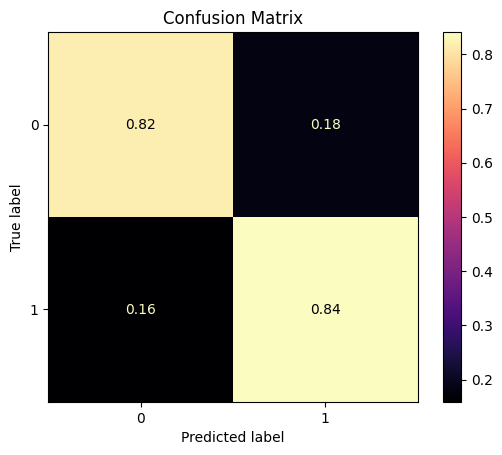

In [ ]:
plot_confusion_matrix(y_pred_glcm, test_y, color = "magma")

### **Displaying incorrectly classified images**
We display some images that the classifier failed to classify correctly

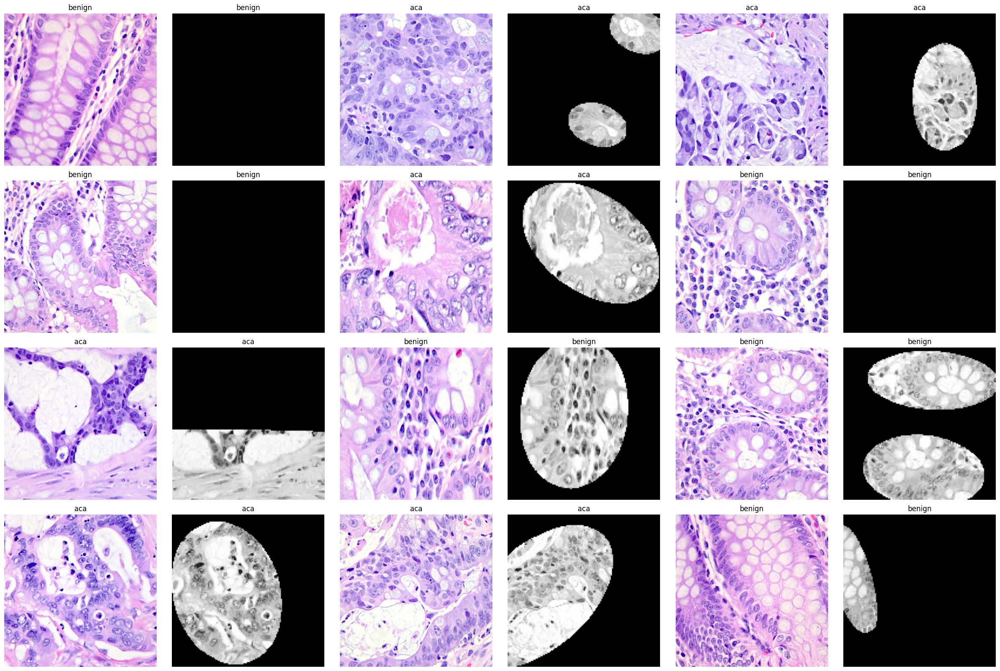

In [ ]:
show_misclassified_images(classifier_glcm,test_set, test_x_glcm, test_y, 12, 6)

# **Classification without detection**
We can now repeat the same process, without applying the image processing. Now the glcm is computed on the whole image.

In [ ]:
combined_df_full = create_dataset(process = False)

In [ ]:
save_dataset_to_csv(combined_df_full, "dataset_full_glcm.csv")

## **Dataset loading**

In [ ]:
combined_df_full = load_dataset_from_csv("dataset_full_glcm.csv")

## **Train, validation and test sets**

In [ ]:
data = combined_df_full
test_size = 0.2
val_size = 0.1
x_train, x_val, x_test, y_train, y_val, y_test = split_dataset(data, test_size, val_size, "Label")
print("train shape:" + str(x_train.shape))
print("val shape:" + str(x_val.shape))
print("test shape:" + str(x_test.shape))

train shape:(7200, 6)
val shape:(800, 6)
test shape:(2000, 6)


In [ ]:
train_set = pd.concat([x_train, x_val], axis=0)
train_x_glcm_f = train_set.drop(columns = ["image"])
train_y = pd.concat([y_train, y_val], axis=0)
test_set = x_test
test_x_glcm_f = x_test.drop(columns=["image"])
test_y = y_test

## **Training phase**

In [ ]:
# Train the SVM classifier pipeline
classifier_glcm_f, best_params_glcm_f, best_score_glcm_f = train_model(train_x_glcm_f, train_y)

## **Accuracy analysis**

In [ ]:
# Print the best hyperparameters and best score
print(f"Best hyperparameters: {best_params_glcm_f}")
print(f"Best validation score: {best_score_glcm_f:.4f}")

# Evaluate the best estimator on the test set
test_score = classifier_glcm_f.score(test_x_glcm_f, test_y)
print(f"Test set score: {test_score:.4f}")
#save_model_to_file(classifier, 'best_svm_model.pkl')

Best hyperparameters: {'svm__C': 1, 'svm__gamma': 1, 'svm__kernel': 'rbf'}
Best validation score: 0.8764
Test set score: 0.8790


In [ ]:
y_pred_glcm_f = classifier_glcm_f.predict(test_x_glcm_f)
classification_metrics(test_y, y_pred_glcm_f)

{'accuracy': 0.879,
 'precision': 0.9091915836101883,
 'recall': 0.836901121304791,
 'f1_score': 0.8715498938428875,
 'true_negatives': 937,
 'false_positives': 82,
 'false_negatives': 160,
 'true_positives': 821}

We compute the average time needed to make the prediction on one image

In [ ]:
def glcm_full_extraction(image):
   res = preprocess_image(image, read = True, resize_after = True)
   f = extract_features(res)
   return pd.DataFrame([f], columns = f.keys())
n = 100
v = average_prediction_time(classifier_glcm_f, df['image'].sample(n).values,glcm_full_extraction)
print(v * 1000)

799.4168734550476


### **Confusion matrix**

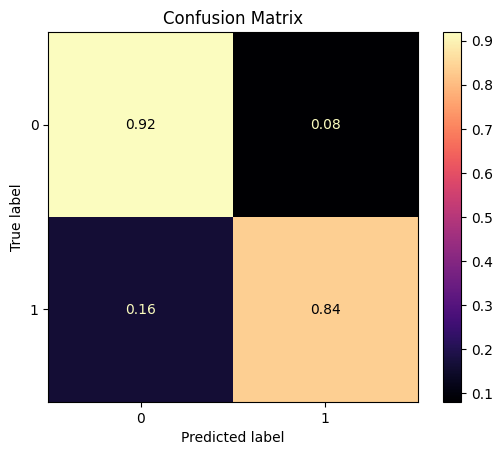

In [ ]:
plot_confusion_matrix(y_pred_glcm_f, test_y, color = "magma")

### **Displaying incorrectly classified images**
We display some images that the classifier failed to classify correctly

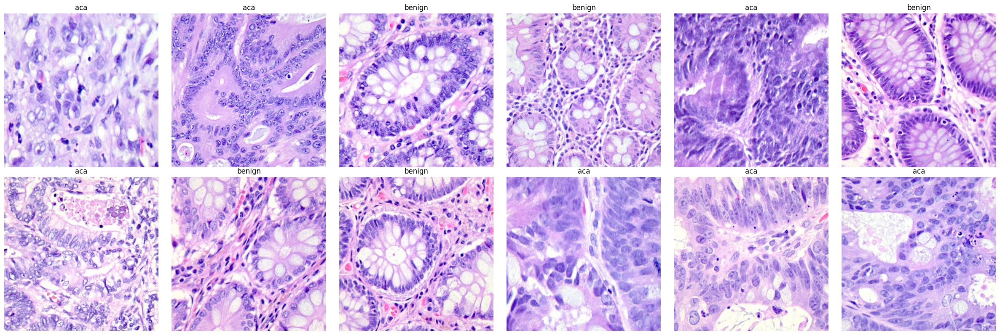

In [ ]:
show_misclassified_images(classifier_glcm,test_set, test_x_glcm, test_y, 12, 6, plot_glcm = False)

# **Feature extraction with CNN**

## **Import of required libraries**

In [ ]:
import tensorflow as tf
from tensorflow import keras
from keras.preprocessing.image import ImageDataGenerator
from keras.optimizers import Adam
from keras.applications import VGG16
from keras.callbacks import EarlyStopping
from tensorflow.keras.callbacks import TensorBoard
from tensorflow.keras.applications import VGG16
from tensorflow.keras.applications.vgg16 import preprocess_input
import datetime
from tensorflow.keras.layers import Input
from joblib import dump, load
import joblib

## **Feature extractor definition**
In this case, we are going to use VVG16 as a feature extractor. We load the already trained model onto `imagenet`, excluding the last fully-connected layers. The network, then, extracts for each image, a 7x7x512 feature tensor.

<img src=https://biolab.csr.unibo.it/vr/esercitazioni/NotebookImages/EsImageClassification\TransferLearning.png width="600">





In [ ]:
img_size = (224, 224)
img_shape = (img_size[0], img_size[1], 3)
feature_extractor = VGG16(weights="imagenet", include_top=False,
	input_tensor=Input(shape=img_shape))

58889256/58889256 [==============================] - 0s 0us/step


Model visualization

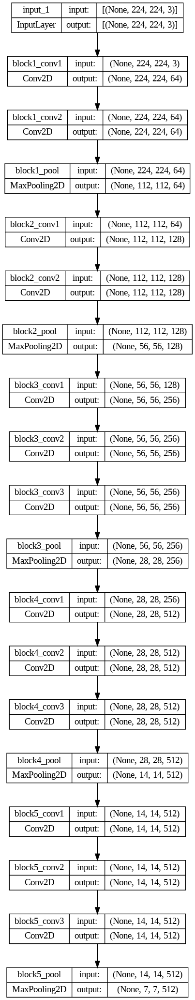

In [ ]:
keras.utils.plot_model(feature_extractor,show_shapes=True)

## **Train and test set**

In [ ]:
data = df
test_size = 0.2
val_size = 0.1
x_train, x_val, x_test, y_train, y_val, y_test = split_dataset(data, test_size, val_size, "label")
print("train shape:" + str(x_train.shape))
print("val shape:" + str(x_val.shape))
print("test shape:" + str(x_test.shape))

train shape:(7200, 1)
val shape:(800, 1)
test shape:(2000, 1)


In [ ]:
train_set = pd.concat([x_train, x_val])
train_set['label'] = pd.concat([y_train, y_val])
train_set = train_set[["label", "image"]]
test_set = x_test
test_set['label'] = y_test
test_set = test_set[["label", "image"]]
train_set.head()
test_y = y_test

## **Image preprocessing**
We define two functions that allow you to go to read an image and perform the preprocessing necessary to use it with VVG16. Using the [**preprocess_input**](https://www.tensorflow.org/api_docs/python/tf/keras/applications/vgg16/preprocess_input) function, images are converted from RGB to BGR, then each channel is centered in zero.




In [ ]:
def load_and_preprocess_image_vgg16(path):
    image = tf.io.read_file(path)
    image = tf.image.decode_jpeg(image, channels=3)
    image = tf.image.resize(image, img_size)  # Resize image to 224x224
    image = preprocess_input(image)
    return image

## **Creating Datasets**

The following code creates and prepares datasets for training and testing using TensorFlow. [**Dataset**](https://www.tensorflow.org/api_docs/python/tf/data/Dataset) is used to efficiently manage the data by avoiding loading all the images into memory.

**VGG16** was originally designed to receive an image of size 224x224x3 as input. To maintain the original input shape, all images must be resized from 768x768x3 to 224x224x3.



In [ ]:
batch_size = 120
train_dataset = tf.data.Dataset.from_tensor_slices(train_set['image'])
train_dataset = train_dataset.map(load_and_preprocess_image_vgg16, num_parallel_calls=tf.data.experimental.AUTOTUNE)
train_dataset = train_dataset.batch(batch_size)
train_dataset = train_dataset.prefetch(buffer_size=tf.data.experimental.AUTOTUNE)

test_dataset = tf.data.Dataset.from_tensor_slices(test_set['image'])
test_dataset =test_dataset.map(load_and_preprocess_image_vgg16, num_parallel_calls=tf.data.experimental.AUTOTUNE)
test_dataset = test_dataset.batch(batch_size)
test_dataset= test_dataset.prefetch(buffer_size=tf.data.experimental.AUTOTUNE)

## **Feature extraction**
We are going to extract the features for each of the 8000 images in the dataset, calling the `predict` of the model defined earlier.

The size of the dataset containing the features will, therefore, be 8000x7x512
(long process).



<img src=https://miro.medium.com/v2/resize:fit:828/format:webp/1*NNifzsJ7tD2kAfBXt3AzEg.png width="600">



In [ ]:
print('Estrazione delle feature...')
train_features_x=feature_extractor.predict(train_dataset)
test_features_x=feature_extractor.predict(test_dataset)
#test_features_x = load_dataset_from_csv("test_features_x.csv")

print('Shape ndarray delle feature di train: ', train_features_x.shape)
print('Shape ndarray delle feature di test: ', test_features_x.shape)

Estrazione delle feature...
17/17 [==============================] - 11s 680ms/step
Shape ndarray delle feature di train:  (8000, 7, 7, 512)
Shape ndarray delle feature di test:  (2000, 7, 7, 512)


We linearize the features to obtain a dataframe of size 8000x25088

In [ ]:
flattened_features_train = train_features_x.reshape(train_features_x.shape[0], -1)
flattened_features_test = test_features_x.reshape(test_features_x.shape[0], -1)

print('Shape ndarray delle feature di train: ', flattened_features_train.shape)
print('Shape ndarray delle feature di test: ', flattened_features_test.shape)
#save_dataset_to_csv(pd.DataFrame(flattened_features_train),"train_features_x.csv")
#save_dataset_to_csv(pd.DataFrame(flattened_features_test), "test_features_x.csv")

Shape ndarray delle feature di train:  (8000, 25088)
Shape ndarray delle feature di test:  (2000, 25088)


## **Dimensionality reduction**
We are going to use the `pca` function defined earlier, to reduce the dimensionality of the dataset. We are going to extract 10 components, so that we have a dataset of size
8000x10. This way we can make a comparison with the 10 glcm features extracted earlier.

In [ ]:
features_number = 10

reduced_train_df = pca(flattened_features_train, features_number)
reduced_test_df, pca_model = pca(flattened_features_test, features_number, True)

#save_dataset_to_csv(reduced_train_df, "train_features_10.csv")
#save_dataset_to_csv(reduced_test_df, "test_features_10.csv")

dump(pca_model, 'pca_model.joblib')
pca_model = joblib.load('pca_model.joblib')
#reduced_train_df = load_dataset_from_csv("train_features_10.csv")
#reduced_test_df = load_dataset_from_csv("test_features_10.csv")

reduced_train_df.head()

,col1,col2,col3,col4,col5,col6,col7,col8,col9,col10
0,-147.952133,-86.612198,-314.169739,147.484451,-57.961082,5.943998,-41.333675,-51.913551,-56.306263,-8.350304
1,34.382568,-210.411118,-58.381809,-53.174137,-53.582939,95.623222,-111.360626,46.345146,213.421387,-187.244583
2,-96.595139,374.726685,256.210175,5.470950,-237.936279,207.687653,-85.408813,-50.179153,-86.420128,62.613091
3,-6.390372,246.238678,-159.489197,270.495636,-174.882645,-51.863297,158.020569,-117.480614,-12.451134,-36.996193
4,207.697876,20.807899,-75.523613,-276.469849,75.624420,-58.571049,-35.370544,-50.845894,-86.400772,17.442554


## **Normalizing**
We normalize features between 0 and 1.

In [ ]:
reduced_norm_train_df = normalize_dataset(reduced_train_df, [])
reduced_norm_test_df = normalize_dataset(reduced_test_df, [])

reduced_norm_train_df.head()

,col1,col2,col3,col4,col5,col6,col7,col8,col9,col10
0,0.211818,0.338454,0.129431,0.654219,0.421478,0.460294,0.383953,0.426468,0.363198,0.427023
1,0.393848,0.235425,0.396662,0.423942,0.426695,0.542560,0.308911,0.543076,0.663487,0.215431
2,0.263088,0.722386,0.725347,0.491149,0.211071,0.649755,0.351911,0.424983,0.341663,0.502374
3,0.353142,0.615457,0.291028,0.795266,0.284506,0.404628,0.572401,0.331668,0.409049,0.398025
4,0.566872,0.427850,0.378743,0.167795,0.577709,0.396195,0.378573,0.425532,0.332827,0.465195


We can use `pca` again to reduce the dataset to 3 dimensions so that we can visualize the distribution of the data.

In [ ]:
features_number = 3

visualize_train_df = pca(reduced_norm_train_df, features_number)

visualize_train_df["Label"] = np.uint8(train_set["label"])

visualize_train_df.head()

,col1,col2,col3,Label
0,-0.147704,-0.328226,0.169227,1
1,0.034326,-0.060994,-0.061048,0
2,-0.096434,0.267691,0.006160,1
3,-0.006380,-0.166630,0.310276,1
4,0.207350,-0.078912,-0.317196,0


<ipython-input-5-a951be6d4e05>:143: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(df.loc[df[label_column] == label_value, columns[0]],


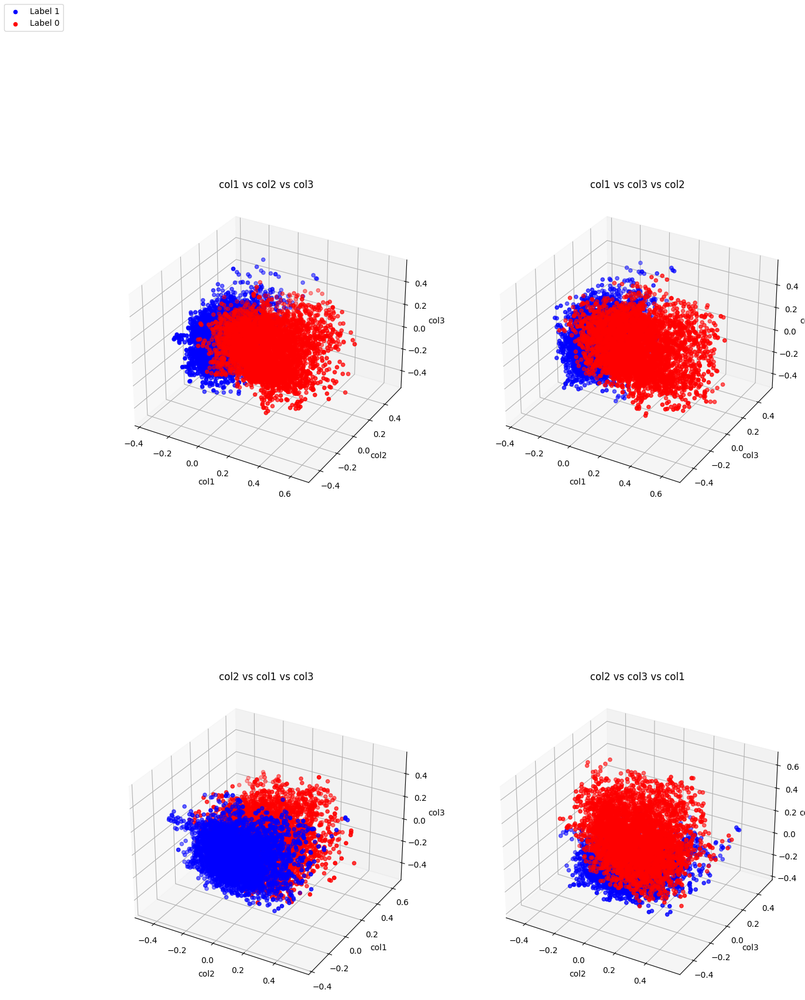

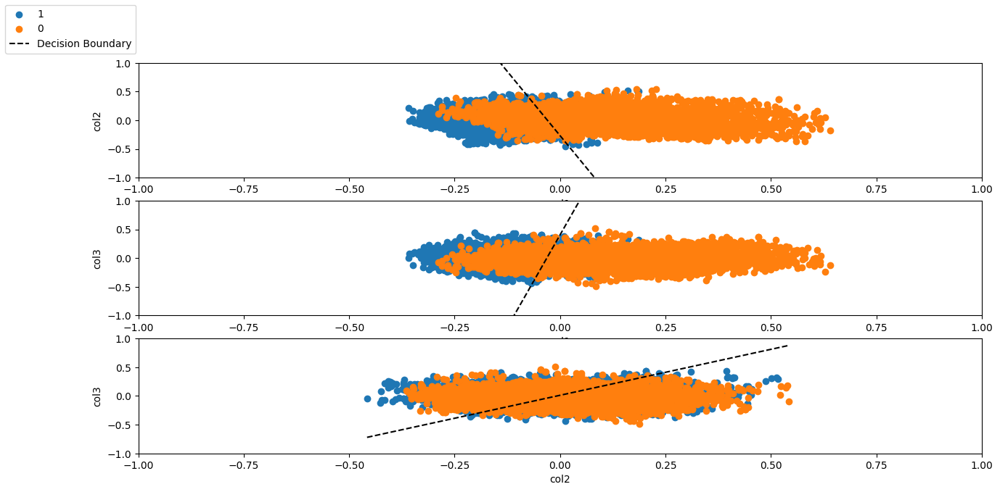

In [ ]:
plot_columns(visualize_train_df, 3, 3, (15,20), "Label", True)
plot_columns(visualize_train_df, 1, 2, (15,7), "Label", False)

We define the dataset that we will use to train the classifier, using the 10 features extracted earlier

In [ ]:
train_x_10 = reduced_train_df
test_x_10 = reduced_test_df
train_y = train_set['label']

## **Classification with SVM**

### **Training phase**
We go on to train the model, using the same function used earlier `train_model()`.

In [ ]:
classifier_10, best_param_10, best_score_10 = train_model(train_x_10,train_y)

/usr/local/lib/python3.10/dist-packages/joblib/externals/loky/backend/fork_exec.py:38: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  pid = os.fork()
/usr/local/lib/python3.10/dist-packages/joblib/externals/loky/backend/fork_exec.py:38: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  pid = os.fork()


## **Accuracy analysis**

In [ ]:
# Print the best hyperparameters and best score
print(f"Best hyperparameters: {best_param_10}")
print(f"Best validation score: {best_score_10:.4f}")

# Evaluate the best estimator on the test set
test_score = classifier_10.score(test_x_10, y_test)
print(f"Test set score: {test_score:.4f}")
#save_model_to_file(classifier, 'best_svm_model.pkl')

Best hyperparameters: {'svm__C': 1, 'svm__gamma': 0.1, 'svm__kernel': 'rbf'}
Best validation score: 0.9894
Test set score: 0.9495


In [ ]:
y_pred_10 = classifier_10.predict(test_x_10)

We compute the average time needed to make the prediction on one image

In [ ]:
def cnn_10_extraction(image):
   res = load_and_preprocess_image_vgg16(image)
   res = np.expand_dims(res, axis=0)
   features = feature_extractor.predict(res)
   features = features.reshape(features.shape[0], -1)
   features = pca_model.transform(features)
   return pd.DataFrame([features[0]], columns = ["col" + str(i) for i in range(1,11)])
n = 100
v = average_prediction_time(classifier_10, df['image'].sample(n).values,cnn_10_extraction)
print(v * 1000)

1/1 [==============================] - 0s 29ms/step
131.07908964157104


In [ ]:
classification_metrics(test_y, y_pred_10)

{'accuracy': 0.9495,
 'precision': 0.9608433734939759,
 'recall': 0.9391560353287537,
 'f1_score': 0.9498759305210918,
 'true_negatives': 942,
 'false_positives': 39,
 'false_negatives': 62,
 'true_positives': 957}

### **Confusion Matrix**
We visualize the confusion matrix to evaluate performance on the test set

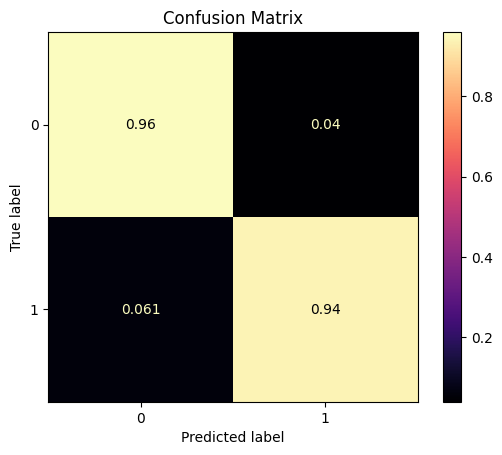

In [ ]:
plot_confusion_matrix(y_pred_10, test_y, color = "magma")

### **Displaying incorrectly classified images**.
We display some images that the classifier failed to classify correctly

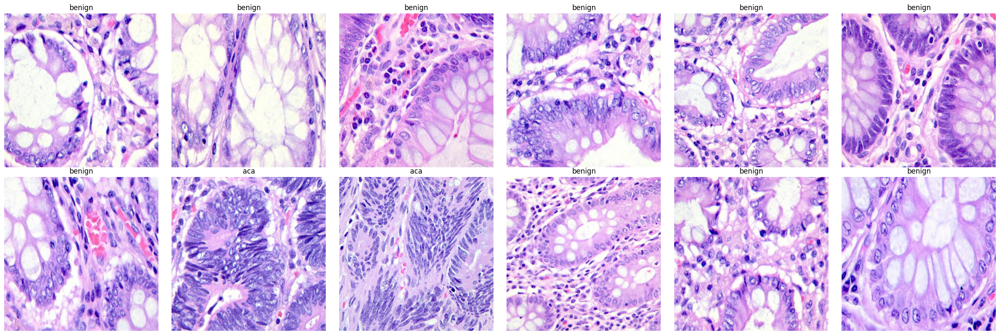

In [ ]:
show_misclassified_images(classifier_10,test_set, test_x_10, y_test, 12, n_images = 6, plot_glcm = False)

## **Analysis with higher dimensionality**

We repeat the training by going this time to create a dataset of dimensionality 20.

In [ ]:
features_number = 20

reduced_train_df = pca(flattened_features_train, features_number)
reduced_test_df, pca_model_20 = pca(flattened_features_test, features_number, True)

dump(pca_model_20, 'pca_model_20.joblib')
#save_dataset_to_csv(reduced_train_df, "train_features_"+str(features_number)+".csv")
#save_dataset_to_csv(reduced_test_df, "test_features_"+str(features_number)+".csv")

#reduced_train_df = load_dataset_from_csv("train_features_"+str(features_number)+".csv")
#reduced_test_df = load_dataset_from_csv("test_features_"+str(features_number)+".csv")

reduced_train_df.describe()

,col1,col2,col3,col4,col5,col6,col7,col8,col9,col10,col11,col12,col13,col14,col15,col16,col17,col18,col19,col20
count,8000.000000,8000.000000,8000.000000,8000.000000,8000.000000,8000.000000,8000.000000,8000.000000,8000.000000,8000.000000,8000.000000,8000.000000,8000.000000,8000.000000,8000.000000,8000.000000,8000.000000,8000.000000,8000.000000,8000.000000
mean,0.000009,-0.000042,0.000040,-0.000041,0.000005,-0.000014,-0.000086,-0.000053,-0.000009,0.000005,-0.000039,-0.000002,-0.000036,0.000008,0.000013,-0.000035,0.000033,0.000012,-0.000002,-0.000014
std,188.552841,162.854507,146.809677,123.508949,112.252625,100.032936,96.634613,95.459305,93.690521,93.439796,91.662308,91.204399,88.581772,86.250618,84.475235,82.377831,81.761345,80.209190,78.603645,76.226158
min,-360.125427,-493.303650,-438.046143,-422.774689,-418.528778,-491.967804,-445.292419,-394.548126,-353.234833,-419.568848,-443.921570,-380.855103,-384.678131,-315.664185,-355.027466,-361.218292,-282.417847,-329.003540,-259.202057,-260.126831
25%,-142.860516,-112.527727,-108.179420,-85.889788,-76.501534,-59.654238,-51.403551,-64.022797,-54.337545,-53.209208,-48.493203,-50.319053,-52.234495,-56.438596,-53.811349,-51.491876,-53.496252,-49.538370,-50.849463,-49.593217
50%,-51.077150,-1.696090,-5.184768,5.541878,-3.746757,-2.909499,-2.816464,0.352108,-0.432757,3.027667,-1.161155,2.959102,-0.591789,-1.242383,0.630576,-1.800178,1.302935,0.423579,0.370095,-0.540768
75%,125.756914,109.970188,100.469137,85.908709,73.176813,57.591821,47.636321,62.391246,53.744976,55.020562,47.753548,51.610147,49.184119,54.262435,54.060861,50.849020,54.086990,48.292371,51.750292,49.095006
max,641.552979,708.310608,519.117798,448.946045,436.110809,585.024414,581.992676,412.790863,507.092743,541.488159,461.541687,419.751587,385.213135,378.051575,473.034424,407.017303,330.558289,376.845154,286.939606,298.454956


We define the dataset that we will use to train the classifier, using the 20 features extracted earlier



In [ ]:
train_x_20 = reduced_train_df
test_x_20 = reduced_test_df

### **Training phase**

In [ ]:
classifier_20, best_param_20, best_score_20 = train_model(train_x_20,train_y)

### **Accuracy analysis**
In this case, the classifier goes into overfitting, going to worse performance on the test set.

In [ ]:
# Print the best hyperparameters and best score
print(f"Best hyperparameters: {best_param_20}")
print(f"Best validation score: {best_score_20:.4f}")

# Evaluate the best estimator on the test set
test_score = classifier_20.score(test_x_20, y_test)
print(f"Test set score: {test_score:.4f}")
#save_model_to_file(classifier, 'best_svm_model.pkl')

Best hyperparameters: {'svm__C': 1, 'svm__gamma': 0.1, 'svm__kernel': 'rbf'}
Best validation score: 0.9940
Test set score: 0.9155


In [ ]:
y_pred_20 = classifier_20.predict(test_x_20)

In [ ]:
classification_metrics(y_test, y_pred_20 )

{'accuracy': 0.9155,
 'precision': 0.9579741379310345,
 'recall': 0.872423945044161,
 'f1_score': 0.9131997945557269,
 'true_negatives': 942,
 'false_positives': 39,
 'false_negatives': 130,
 'true_positives': 889}

In [ ]:
def cnn_20_extraction(image):
   res = load_and_preprocess_image_vgg16(image)
   res = np.expand_dims(res, axis=0)
   features = feature_extractor.predict(res)
   features = features.reshape(features.shape[0], -1)
   features = pca_model_20.transform(features)
   print(features.shape)
   return pd.DataFrame([features[0]], columns = ["col" + str(i) for i in range(1,21)])
n = 100
v = average_prediction_time(classifier_20, df['image'].sample(n).values,cnn_20_extraction)
print(v * 1000)

1/1 [==============================] - 0s 86ms/step
(1, 20)
1/1 [==============================] - 0s 56ms/step
(1, 20)
1/1 [==============================] - 0s 89ms/step
(1, 20)
1/1 [==============================] - 0s 74ms/step
(1, 20)
1/1 [==============================] - 0s 29ms/step
(1, 20)
1/1 [==============================] - 0s 83ms/step
(1, 20)
1/1 [==============================] - 0s 78ms/step
(1, 20)
1/1 [==============================] - 0s 30ms/step
(1, 20)
1/1 [==============================] - 0s 85ms/step
(1, 20)
1/1 [==============================] - 0s 99ms/step
(1, 20)
1/1 [==============================] - 0s 83ms/step
(1, 20)
1/1 [==============================] - 0s 52ms/step
(1, 20)
1/1 [==============================] - 0s 96ms/step
(1, 20)
1/1 [==============================] - 0s 73ms/step
(1, 20)
1/1 [==============================] - 0s 105ms/step
(1, 20)
1/1 [==============================] - 0s 95ms/step
(1, 20)
1/1 [==============================] - 

### **Confusion Matrix**
We visualize the confusion matrix to evaluate performance on the test set

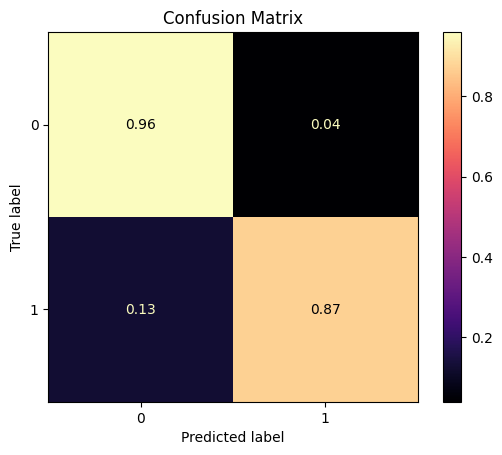

In [ ]:
plot_confusion_matrix(y_pred_20, test_y, color = "magma")

### **Displaying incorrectly classified images**.
We display some images that the classifier failed to classify correctly


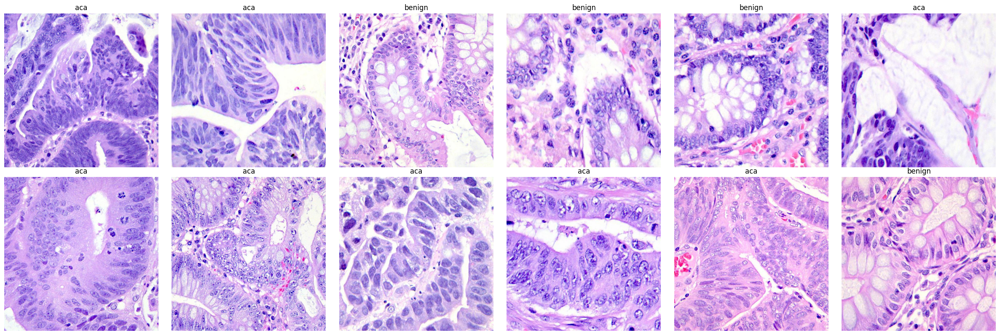

In [ ]:
show_misclassified_images(classifier_20,test_set, test_x_20, y_test, 12, n_images = 6, plot_glcm = False)

## **Comparison of the two classifiers**
Let's display the images that are misclassified by both classifiers

In [ ]:
glcm_wrong_predictions = get_misclassified_indices(classifier_glcm_f, test_x_glcm_f, test_y)
vgg16_wrong_predictions = get_misclassified_indices(classifier_10, test_x_10, test_y)

glcm_false_positive = glcm_wrong_predictions[(glcm_wrong_predictions['predicted'] == 1) & (glcm_wrong_predictions['real'] == 0)]['index']
vgg16_false_positive = vgg16_wrong_predictions[(vgg16_wrong_predictions['predicted'] == 1) & (vgg16_wrong_predictions['real'] == 0)]['index']

common_elements = np.intersect1d(glcm_false_positive, vgg16_false_positive)
show_misclassified_images(classifier_10, test_set, test_x_10.iloc[common_elements],
                          y_test.iloc[common_elements], len(common_elements),
                          n_images = 2, plot_glcm = False)


# **Classification with CNN**
We are going to define a Convolutional Neural Network, which will be trained on the dataset images. This time it will be used to classify the images and not just to extract features. Again we are going to use VGG16 (pre-trained) to extract the features generated at the intermediate levels during the forward step.

## **Import of required libraries**

In [ ]:
from tensorflow.keras import Sequential
from tensorflow.keras.layers import Input, Dense, Conv2D, MaxPooling2D, Dropout, Flatten, BatchNormalization, Activation, GlobalAveragePooling2D
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from keras.callbacks import EarlyStopping, ModelCheckpoint
from tensorflow.keras import regularizers

## **Utility functions**

In [ ]:
def plot_history(history,metric=None):
  fig, ax1 = plt.subplots(figsize=(10, 8))

  epoch_count=len(history.history['loss'])

  line1,=ax1.plot(range(1,epoch_count+1),history.history['loss'],label='train_loss',color='orange')
  ax1.plot(range(1,epoch_count+1),history.history['val_loss'],label='val_loss',color = line1.get_color(), linestyle = '--')
  ax1.set_xlim([1,epoch_count])
  ax1.set_ylim([0, max(max(history.history['loss']),max(history.history['val_loss']))])
  ax1.set_ylabel('loss',color = line1.get_color())
  ax1.tick_params(axis='y', labelcolor=line1.get_color())
  ax1.set_xlabel('Epochs')
  _=ax1.legend(loc='lower left')

  if (metric!=None):
    ax2 = ax1.twinx()
    line2,=ax2.plot(range(1,epoch_count+1),history.history[metric],label='train_'+metric)
    ax2.plot(range(1,epoch_count+1),history.history['val_'+metric],label='val_'+metric,color = line2.get_color(), linestyle = '--')
    ax2.set_ylim([0, max(max(history.history[metric]),max(history.history['val_'+metric]))])
    ax2.set_ylabel(metric,color=line2.get_color())
    ax2.tick_params(axis='y', labelcolor=line2.get_color())
    _=ax2.legend(loc='upper right')

## **Defining the dataset**
We can now create the dataset containing the image paths and their respective labels

In [ ]:
colon_aca = load_images_to_dataframe('dataset/colon_aca', 1)
colon_n = load_images_to_dataframe('dataset/colon_n', 0)
class_labels = ['benign', 'aca']

# Concatenate the dataframes
df = pd.concat([colon_aca, colon_n], ignore_index=True)
df.describe()
df.head()

,image,label
0,dataset/colon_aca/colonca4894.jpeg,1
1,dataset/colon_aca/colonca4112.jpeg,1
2,dataset/colon_aca/colonca113.jpeg,1
3,dataset/colon_aca/colonca858.jpeg,1
4,dataset/colon_aca/colonca3597.jpeg,1


In [ ]:
df.describe()

,label
count,10000.000000
mean,0.500000
std,0.500025
min,0.000000
25%,0.000000
50%,0.500000
75%,1.000000
max,1.000000


## **Train, validation and test**

In [ ]:
test_size = 0.2
val_size = 0.1
x_train, x_val, x_test, y_train, y_val, y_test = split_dataset(df, test_size, val_size, "label")
y_train = ["aca" if e == 1 else "benign" for e in y_train]
y_val = ["aca" if e == 1 else "benign" for e in y_val]
y_test = ["aca" if e == 1 else "benign" for e in y_test]

## **Preparing the dataset**

We are going to use the `ImageDataGenerator` class, which allows us to define a 224x224x3 rgb image generator in a lazy manner, avoiding having to load all the images into memory.

This generator also allows us to be able to apply different augmentation techniques on the images, so that at each epoch, the same image will be viewed by the network differently.

In [ ]:
img_size = (224,224)
# Define data augmentation generator
train_gen = ImageDataGenerator(
    preprocessing_function=preprocess_input,
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)
val_gen = ImageDataGenerator(
    preprocessing_function=preprocess_input,
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)
test_gen = ImageDataGenerator(
    preprocessing_function=preprocess_input,
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

train_df = pd.DataFrame({'image': x_train['image'], 'label': y_train})
val_df = pd.DataFrame({"image": x_val['image'], 'label': y_val})
test_df = pd.DataFrame({"image": x_test['image'], 'label': y_test})

batch_size = 32

train_gen = train_gen.flow_from_dataframe(train_df, x_col= 'image', y_col= 'label', target_size= img_size, class_mode= 'categorical',
                                    color_mode= 'rgb', shuffle= True, batch_size= batch_size)

val_gen = val_gen.flow_from_dataframe(val_df, x_col= 'image', y_col= 'label', target_size= img_size, class_mode= 'categorical',
                                        color_mode= 'rgb', shuffle= True, batch_size= batch_size)

test_gen = test_gen.flow_from_dataframe(test_df, x_col= 'image', y_col= 'label', target_size= img_size, class_mode= 'categorical',
                                    color_mode= 'rgb', shuffle= False, batch_size= 1)


Found 7200 validated image filenames belonging to 2 classes.
Found 800 validated image filenames belonging to 2 classes.
Found 2000 validated image filenames belonging to 2 classes.


## **Model definition**
The parameters are:
- `base_model`: The pre-trained base model that will be used as the feature extractor. The weights of this model are frozen to avoid having to retrain the whole network.
- `input_shape` : size of the model input.
- `output_class_count`: number of classes in the model output.

Following the last layer of the network used as a feature extractor, the following layers are added:
   - `GlobalAveragePooling2D()`: A global pooling layer that applies AveragePooling on each 7x7 filter, reducing it to a single value. This operation reduces the feature size from 7x7x712 to 1x512, helping to reduce the number of parameters and preventing overfitting.
   - `Dense(256)`: A fully-connected layer with 256 neurons and ReLU activation function.
   - `Dropout(0.5)`: A dropout layer that `deactivates' 50% of the neurons, during the training phase, to prevent overfitting.
   - `Dense(128)`: Another dense layer with 128 neurons and ReLU activation function.
   - `Dense(output_class_count)`: An output layer with a number of neurons equal to the number of output classes, with softmax activation function.




In [ ]:
def cnn_model(base_model, input_shape=(128, 128, 1), output_class_count = 1):
  base_model.trainable = False
  model=keras.Sequential(
            [
                base_model,
                GlobalAveragePooling2D(name='GlobalAveragePooling2d'),
                Dense(256, activation='relu',name='FC-Layer256'),
                Dropout(0.5, name='DropoutLayer'),
                Dense(128, activation='relu',name='FC-Layer128'),
                Dense(units=output_class_count,activation='softmax',name='Output')
            ]
        )
  return model

## **Defining the feature extractor**
Again, we are going to use VVG16, such as feature extractor

In [ ]:
input_shape = (img_size[0], img_size[1], 3)
feature_extractor = VGG16(weights="imagenet", include_top=False, input_tensor=Input(shape=input_shape))

58889256/58889256 [==============================] - 3s 0us/step


## **Model visualization**

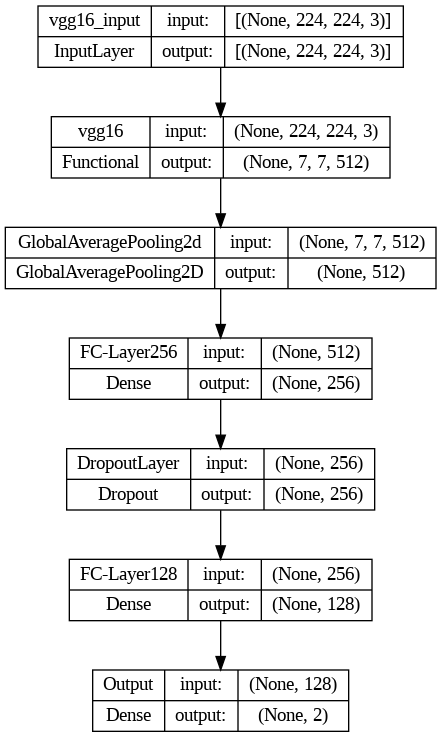

In [ ]:
model = cnn_model(feature_extractor, input_shape, 2)
keras.utils.plot_model(model,show_shapes=True)

In [ ]:
model.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 vgg16 (Functional)          (None, 7, 7, 512)         14714688  
                                                                 
 GlobalAveragePooling2d (Gl  (None, 512)               0         
 obalAveragePooling2D)                                           
                                                                 
 FC-Layer256 (Dense)         (None, 256)               131328    
                                                                 
 DropoutLayer (Dropout)      (None, 256)               0         
                                                                 
 FC-Layer128 (Dense)         (None, 128)               32896     
                                                                 
 Output (Dense)              (None, 2)                 258       
                                                      

## **Model compilation**
We use `Adam` as the optimizer, with an initial learning rate of 0.001.

As loss we use `binary-crossentropy`, since it is a binary classification problem.

In [ ]:
opt = keras.optimizers.Adam(learning_rate= 0.001)

model.compile(optimizer = opt, loss= 'binary_crossentropy', metrics= ['accuracy'])

In [ ]:
model.load_weights('cnn (1).h5')

## **Training phase**
We go to train the model on the training set. We use two callbacks:
- **Model Checkpoint**: useful to save the model at the end of each epoch if the loss has improved.
- **Early Stopping**: useful to stop training if the loss does not improve.

In [ ]:
early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
checkpointer = ModelCheckpoint(filepath='model.weights.h5',
                               save_weights_only=False,
                               verbose=1, save_best_only=True)
epochs = 25

h = model.fit(train_gen, epochs=epochs,
              validation_data=val_gen, callbacks=[checkpointer, early_stopping])

Epoch 1/25
225/225 [==============================] - ETA: 0s - loss: 0.2360 - accuracy: 0.9312
Epoch 1: val_loss improved from inf to 0.05566, saving model to model.weights.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


225/225 [==============================] - 146s 639ms/step - loss: 0.2360 - accuracy: 0.9312 - val_loss: 0.0557 - val_accuracy: 0.9850
Epoch 2/25
225/225 [==============================] - ETA: 0s - loss: 0.0828 - accuracy: 0.9710
Epoch 2: val_loss improved from 0.05566 to 0.04761, saving model to model.weights.h5
225/225 [==============================] - 137s 610ms/step - loss: 0.0828 - accuracy: 0.9710 - val_loss: 0.0476 - val_accuracy: 0.9837
Epoch 3/25
225/225 [==============================] - ETA: 0s - loss: 0.0722 - accuracy: 0.9746

We save the model

In [ ]:
model.save('cnn.keras')

In [ ]:
model.save_weights('weights_cnn')

We visualize the progress of loss, during training

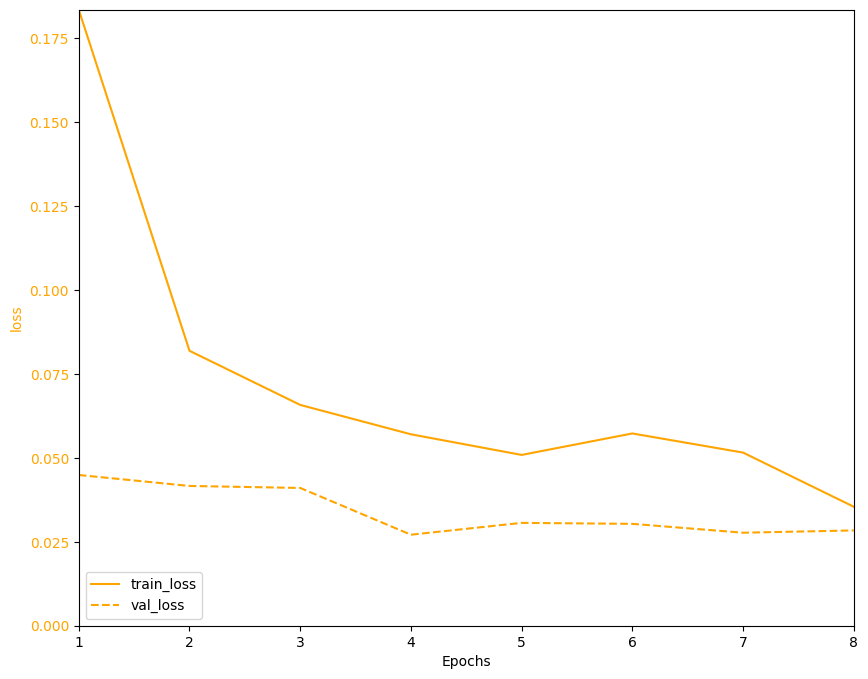

In [ ]:
plot_history(h)

## **Evaluate performance on the test set**
It is possible to evaluate performance on the test set, using the **evaluate** method of the model.

In [ ]:
results = model.evaluate(test_gen, batch_size=batch_size,verbose=0)
print('Loss: {:.3f} Accuracy: {:.3f}'.format(results[0],results[1]))

### **Confusion matrix**
To evaluate the classification accuracy could be useful to compute the confusion matrix.

The following code calls the [**predict**](https://keras.io/api/models/model_training_apis/#predict-method) method to generate output predictions (*test_conf_pred*) for the test set (*test_x*). The output predictions contain, for each evaluated image, the probability values that the image belongs to each of the classes of the problem.

In [ ]:
test_conf_pred=model.predict(test_gen)
print('Output predictions shape: ',test_conf_pred.shape)

   6/2000 [..............................] - ETA: 15:50

The predicted class of each evaluated image (*test_y_pred*) can be obtained by selecting the class with the highest probability.

In [ ]:
test_y_pred =np.argsort(test_conf_pred,axis=1)[:,-1]
print('Class predictions shape: ',test_y_pred.shape)

Class predictions shape:  (2000,)


The evaluated images correctly classified can be identified by comparing the predicted classes (*test_y_pred*) with respect to the ground truth (*test_y*).

In [ ]:
y_test_labels = [0 if l == "aca" else 1 for l in y_test]
correct = np.equal(test_y_pred,y_test_labels)
accuracy=correct.sum()/len(correct)
print('Test set accuracy: {:.3f}'.format(accuracy))

Test set accuracy: 0.986


In [ ]:
classification_metrics(y_test_labels, test_y_pred)

{'accuracy': 0.986,
 'precision': 0.9798590130916415,
 'recall': 0.9918450560652395,
 'f1_score': 0.9858156028368794,
 'true_negatives': 999,
 'false_positives': 20,
 'false_negatives': 8,
 'true_positives': 973}

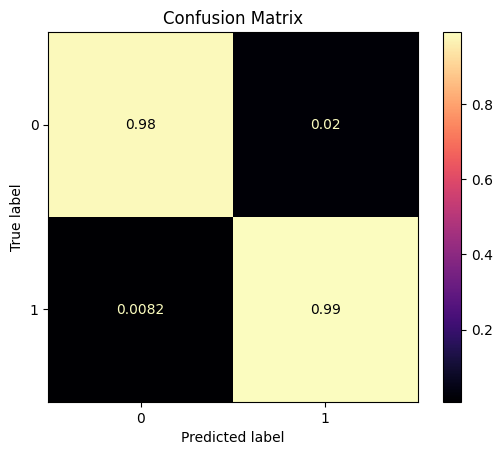

In [ ]:
plot_confusion_matrix(test_y_pred, y_test_labels, color = "magma")

In [ ]:
def cnn_extraction(image_path):
   image = cv2.imread(image_path)
   image = resize_image(image, (img_size))
   print(image.shape)
   res = preprocess_input(image)
   res = np.expand_dims(res, axis=0)
   print(res.shape)
   return res
n = 100
v = average_prediction_time(model, df['image'].sample(n).values,cnn_extraction)
print(v * 1000)

(224, 224, 3)
(1, 224, 224, 3)
1/1 [==============================] - 0s 382ms/step
(224, 224, 3)
(1, 224, 224, 3)
1/1 [==============================] - 0s 33ms/step
(224, 224, 3)
(1, 224, 224, 3)
1/1 [==============================] - 0s 29ms/step
(224, 224, 3)
(1, 224, 224, 3)
1/1 [==============================] - 0s 55ms/step
(224, 224, 3)
(1, 224, 224, 3)
1/1 [==============================] - 0s 32ms/step
(224, 224, 3)
(1, 224, 224, 3)
1/1 [==============================] - 0s 30ms/step
(224, 224, 3)
(1, 224, 224, 3)
1/1 [==============================] - 0s 29ms/step
(224, 224, 3)
(1, 224, 224, 3)
1/1 [==============================] - 0s 30ms/step
(224, 224, 3)
(1, 224, 224, 3)
1/1 [==============================] - 0s 29ms/step
(224, 224, 3)
(1, 224, 224, 3)
1/1 [==============================] - 0s 28ms/step
(224, 224, 3)
(1, 224, 224, 3)
1/1 [==============================] - 0s 32ms/step
(224, 224, 3)
(1, 224, 224, 3)
1/1 [==============================] - 0s 116ms/step
(2